# Imports

In [1045]:
%matplotlib inline
%load_ext tensorboard
import matplotlib.pyplot as plt
import numpy as np
from openslide import open_slide, __library_version__ as openslide_version
import os
from PIL import Image
from skimage.color import rgb2gray
import tensorflow as tf
import pathlib
import progressbar
import sys
import datetime
from sklearn.metrics import confusion_matrix
import seaborn as sns
import sklearn
from sklearn.metrics import roc_auc_score
from scipy.ndimage import measurements, binary_dilation
from tensorflow.keras.utils import plot_model

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


# Image Bounding 

Most of the slides had large empty portions surrounding the specimens. To avoid having to process these empty spaces, we created a dictionary of bounding coordinates for each slide. These coordinates allowed us to crop each slide during processing. 

In [455]:
root_data_path = "/Users/Daniel/Downloads/ADL Final Project Data/slides/"
root_data_directory = pathlib.Path(root_data_path)
paths = list(root_data_directory.glob("*.tif"))
paths = [str(i) for i in paths]

### Data Exploration Without Bounds

Text(0.5, 1.0, 'tumor_016_mask.tif')

Text(0.5, 1.0, 'tumor_002_mask.tif')

Text(0.5, 1.0, 'tumor_001_mask.tif')

Text(0.5, 1.0, 'tumor_005_mask.tif')

Text(0.5, 1.0, 'tumor_012_mask.tif')

Text(0.5, 1.0, 'tumor_101_mask.tif')

Text(0.5, 1.0, 'tumor_075_mask.tif')

Text(0.5, 1.0, 'tumor_059_mask.tif')

Text(0.5, 1.0, 'tumor_110_mask.tif')

Text(0.5, 1.0, 'tumor_064_mask.tif')

Text(0.5, 1.0, 'tumor_096_mask.tif')

Text(0.5, 1.0, 'tumor_081_mask.tif')

Text(0.5, 1.0, 'tumor_094_mask.tif')

Text(0.5, 1.0, 'tumor_057_mask.tif')

Text(0.5, 1.0, 'tumor_084_mask.tif')

Text(0.5, 1.0, 'tumor_091_mask.tif')

Text(0.5, 1.0, 'tumor_078_mask.tif')

Text(0.5, 1.0, 'tumor_023_mask.tif')

Text(0.5, 1.0, 'tumor_035_mask.tif')

Text(0.5, 1.0, 'tumor_019_mask.tif')

/Users/Daniel/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Text(0.5, 1.0, 'tumor_031_mask.tif')

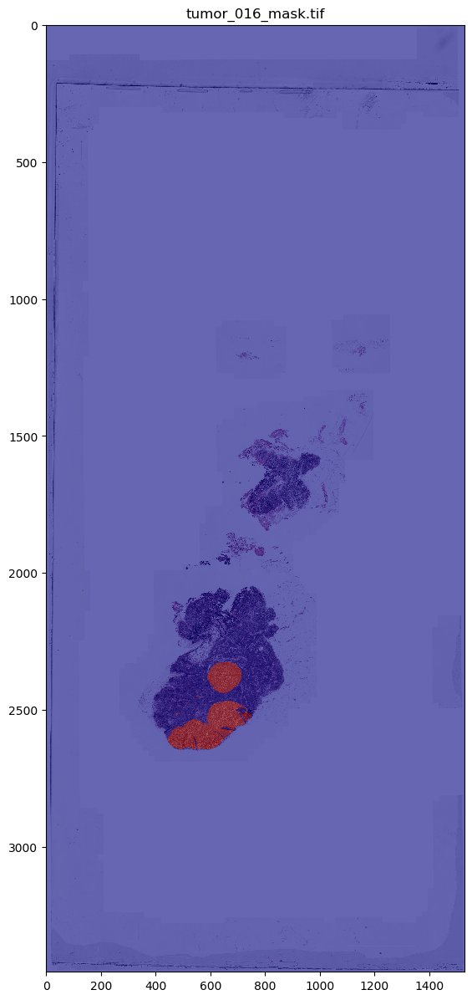

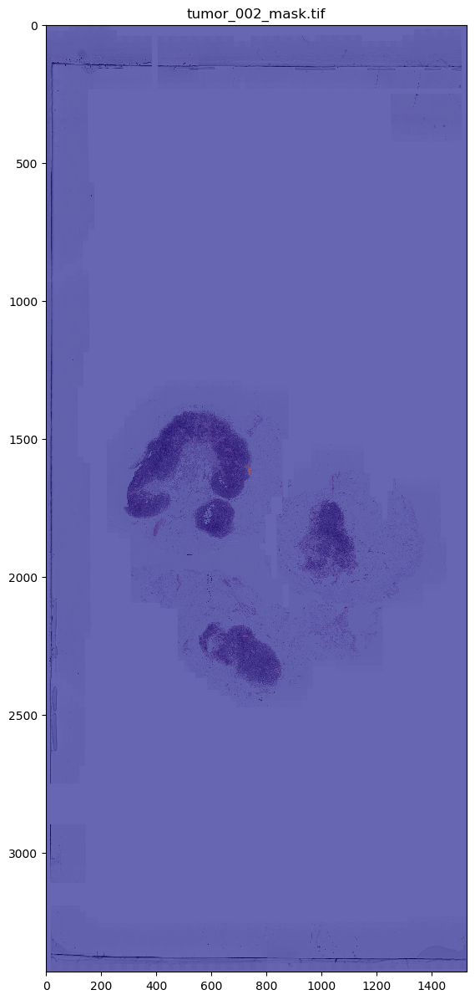

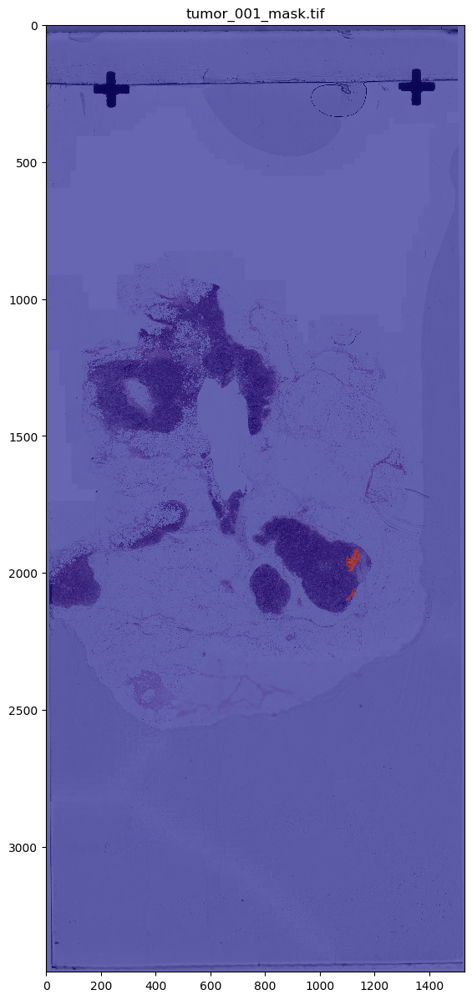

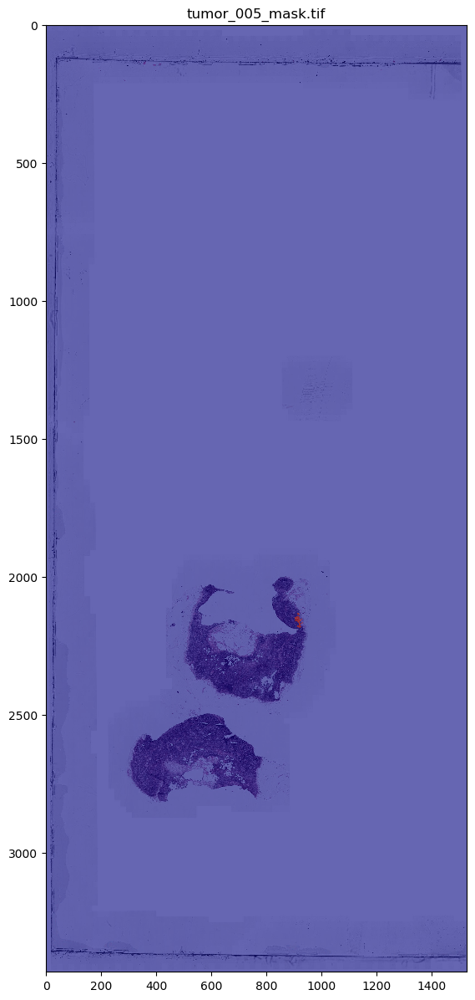

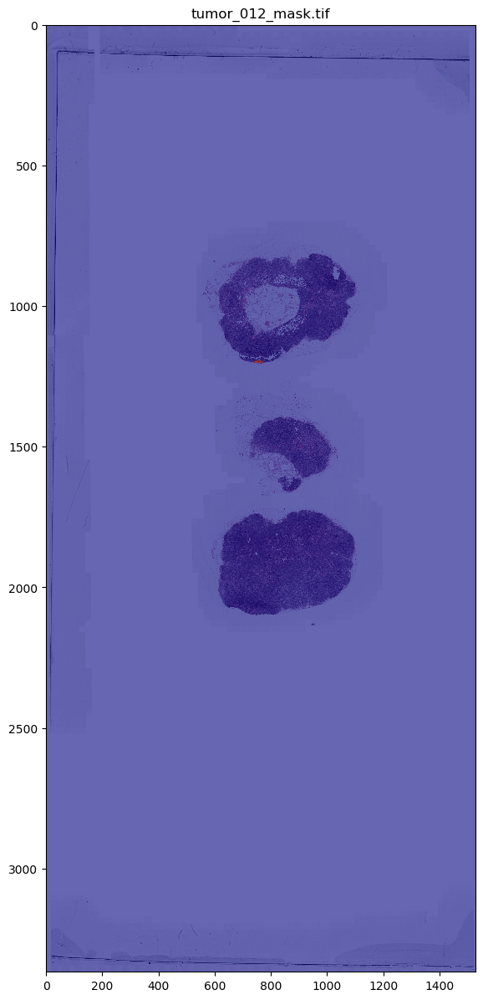

...

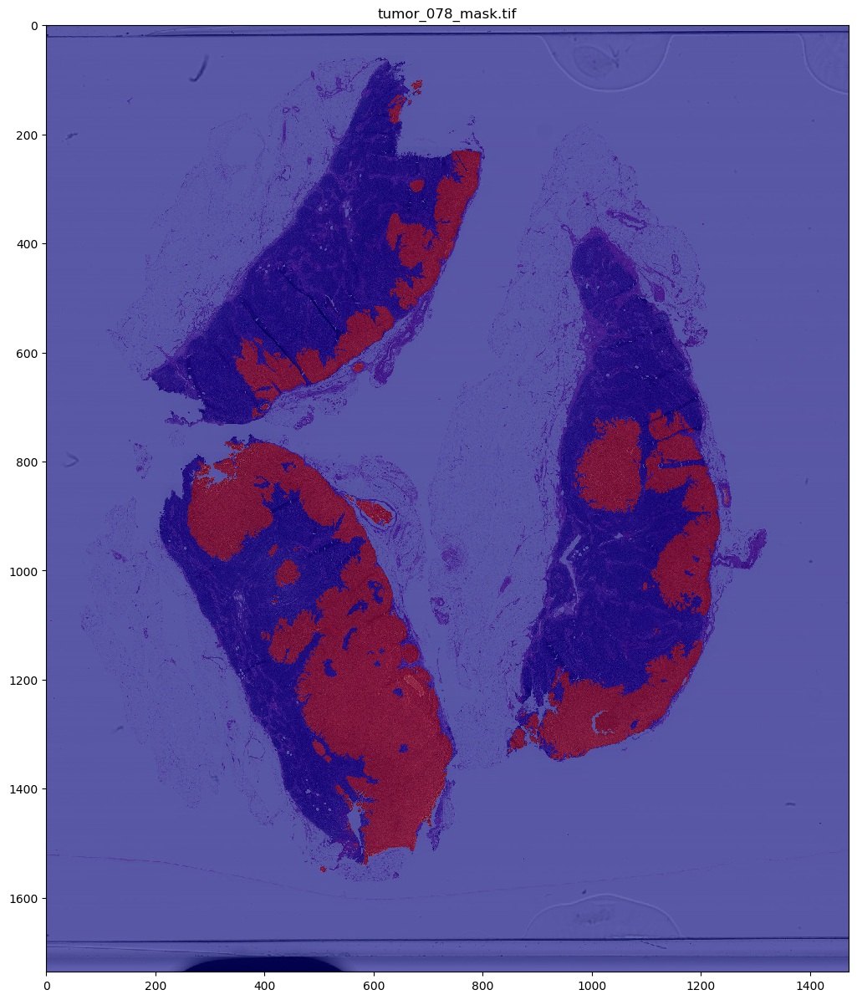

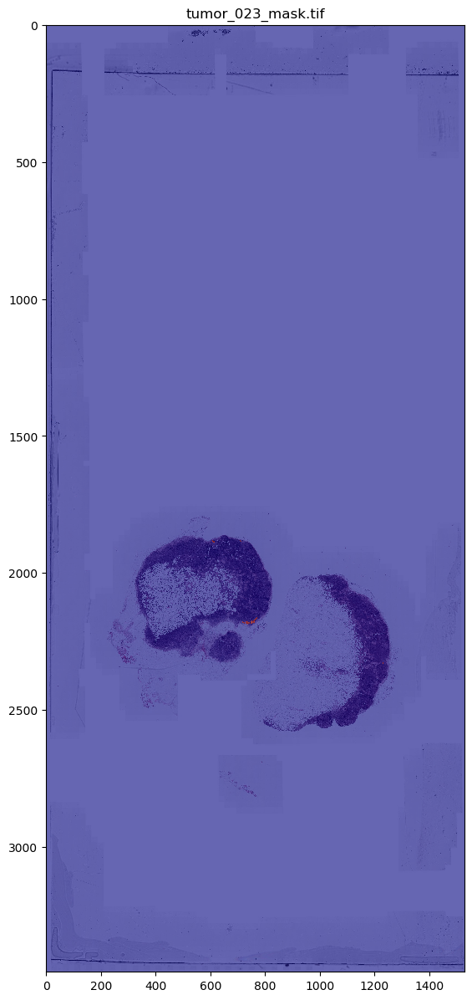

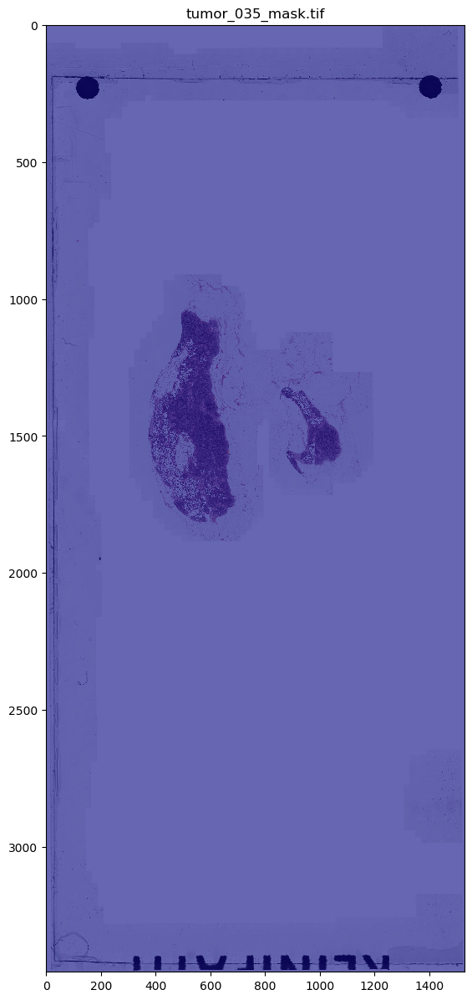

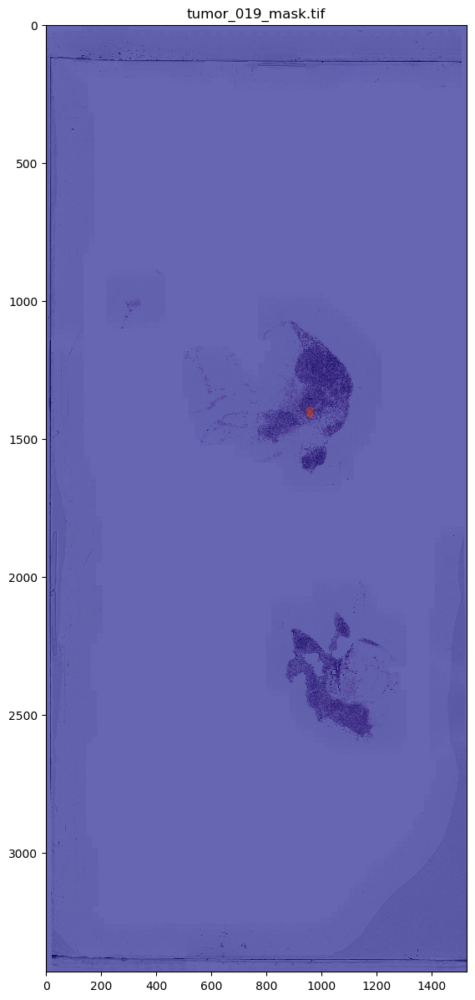

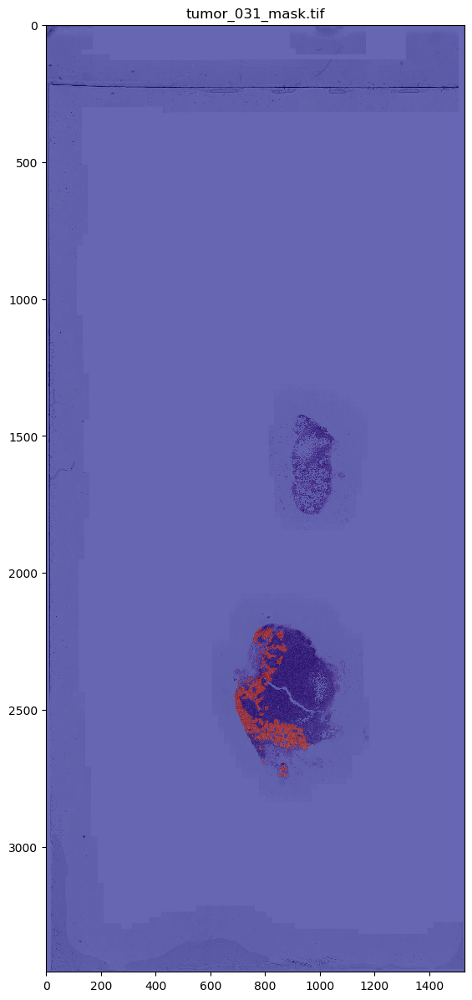

In [450]:
for path in paths:
    if "mask" in path:
        continue
    slide = open_slide(path)
    path = path.split(".")[0]+"_mask."+path.split(".")[1] 
    mask_slide = open_slide(path)
    slide_image = read_slide(slide, 
                         x=0,y=0,
                         level=6, 
                         width=slide.level_dimensions[6][0], 
                         height=slide.level_dimensions[6][1])
    mask_image = read_slide(mask_slide, 
                         x=0,y=0,
                         level=6, 
                         width=slide.level_dimensions[6][0], 
                         height=slide.level_dimensions[6][1])[:,:,0]



    fig = plt.figure(figsize=(15,15), dpi=100)
    plt.title(path.split("/")[-1])
    plt.imshow(slide_image)
    plt.imshow(mask_image, cmap='jet', alpha=.6)

### Data Exploration With Bounds

In [460]:
# level 6 coordinates
slide_selections = {
    "tumor_031":{"x":[400,1200],"y":[2000,2900]},
    "tumor_019":{"x":[600,1200],"y":[900,1700]},
    "tumor_023":{"x":[100,1000],"y":[1600,2400]},
    "tumor_078":{"x":[50,1400],"y":[50,1700]},
    "tumor_091":{"x":[50,950],"y":[200,800]},
    "tumor_084":{"x":[50,1000],"y":[50,1100]},
    "tumor_057":{"x":[50,550],"y":[2100,2700]},
    "tumor_094":{"x":[800,1600],"y":[50,900]},
    "tumor_081":{"x":[300,900],"y":[300,900]},
    "tumor_096":{"x":[50,1100],"y":[50,1100]},
    "tumor_064":{"x":[50,1500],"y":[1500,3000]},
    "tumor_110":{"x":[50,1200],"y":[50,1100]},
    "tumor_075":{"x":[50,850],"y":[500,1100]},
    "tumor_101":{"x":[50,1000],"y":[50,900]},
    "tumor_012":{"x":[500,1100],"y":[700,1400]},
    "tumor_005":{"x":[400,1150],"y":[1900,2500]},
    "tumor_001":{"x":[700,1400],"y":[1500,2400]},
    "tumor_002":{"x":[100,1000],"y":[1300,2100]},
    "tumor_016": {"x":[100,1000],"y":[1900,2900]}
}

Below we produce images of the cropped slides.

Text(0.5, 1.0, 'tumor_031.tif')

Text(0.5, 1.0, 'tumor_019.tif')

Text(0.5, 1.0, 'tumor_023.tif')

Text(0.5, 1.0, 'tumor_078.tif')

Text(0.5, 1.0, 'tumor_091.tif')

Text(0.5, 1.0, 'tumor_084.tif')

Text(0.5, 1.0, 'tumor_057.tif')

Text(0.5, 1.0, 'tumor_094.tif')

Text(0.5, 1.0, 'tumor_081.tif')

Text(0.5, 1.0, 'tumor_096.tif')

Text(0.5, 1.0, 'tumor_064.tif')

Text(0.5, 1.0, 'tumor_110.tif')

Text(0.5, 1.0, 'tumor_075.tif')

Text(0.5, 1.0, 'tumor_101.tif')

Text(0.5, 1.0, 'tumor_012.tif')

Text(0.5, 1.0, 'tumor_005.tif')

Text(0.5, 1.0, 'tumor_001.tif')

Text(0.5, 1.0, 'tumor_002.tif')

Text(0.5, 1.0, 'tumor_016.tif')

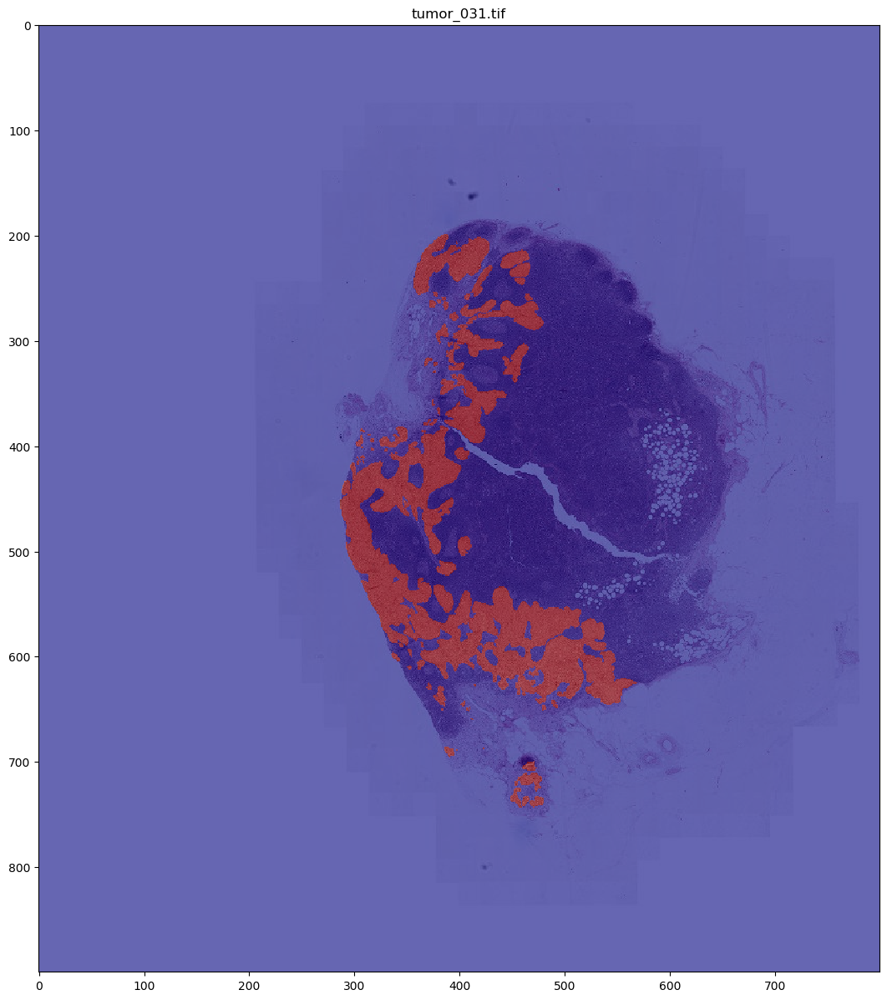

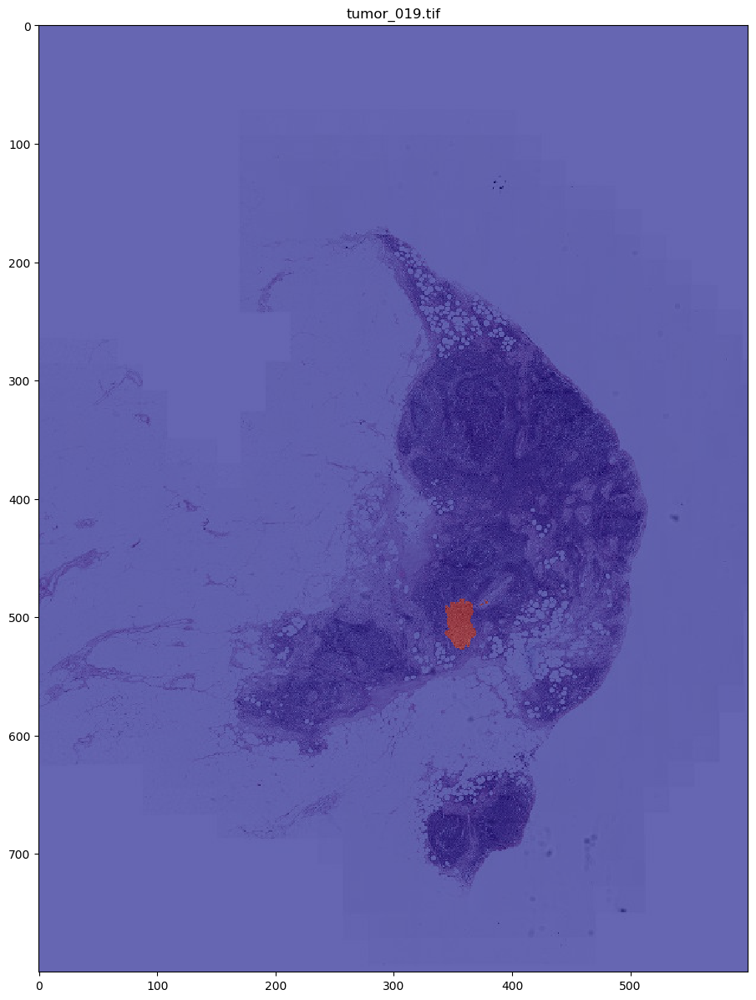

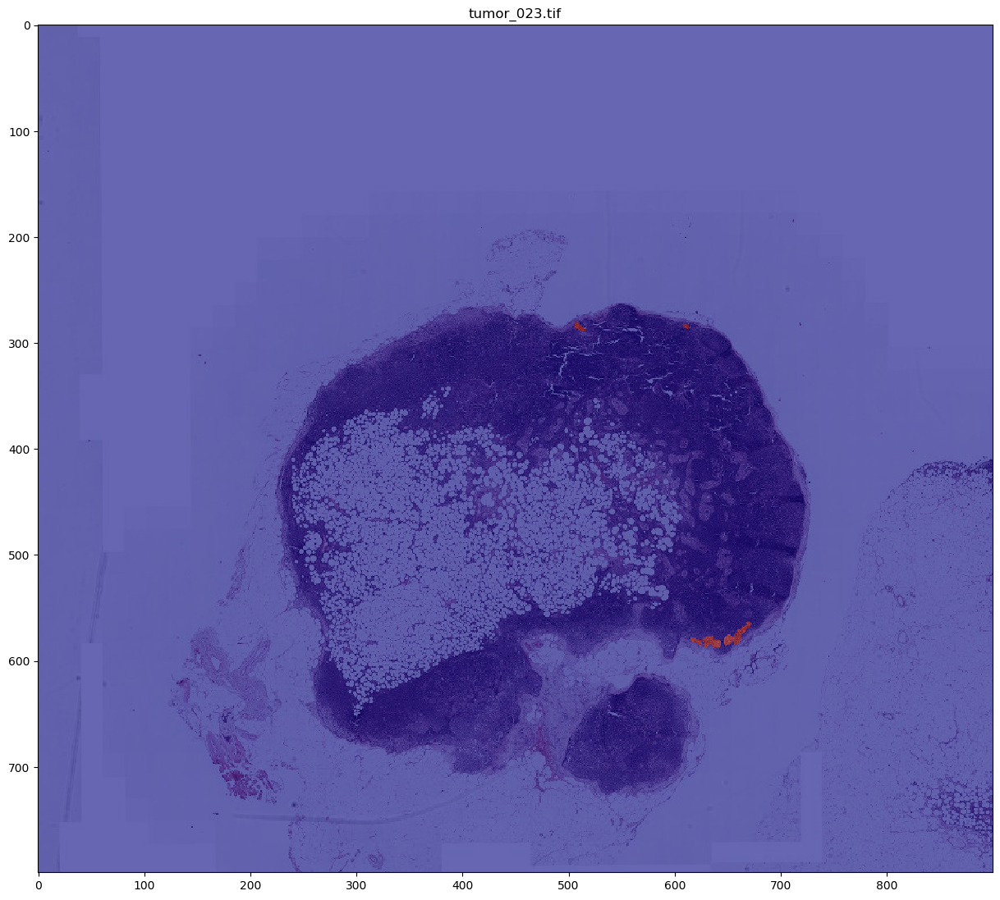

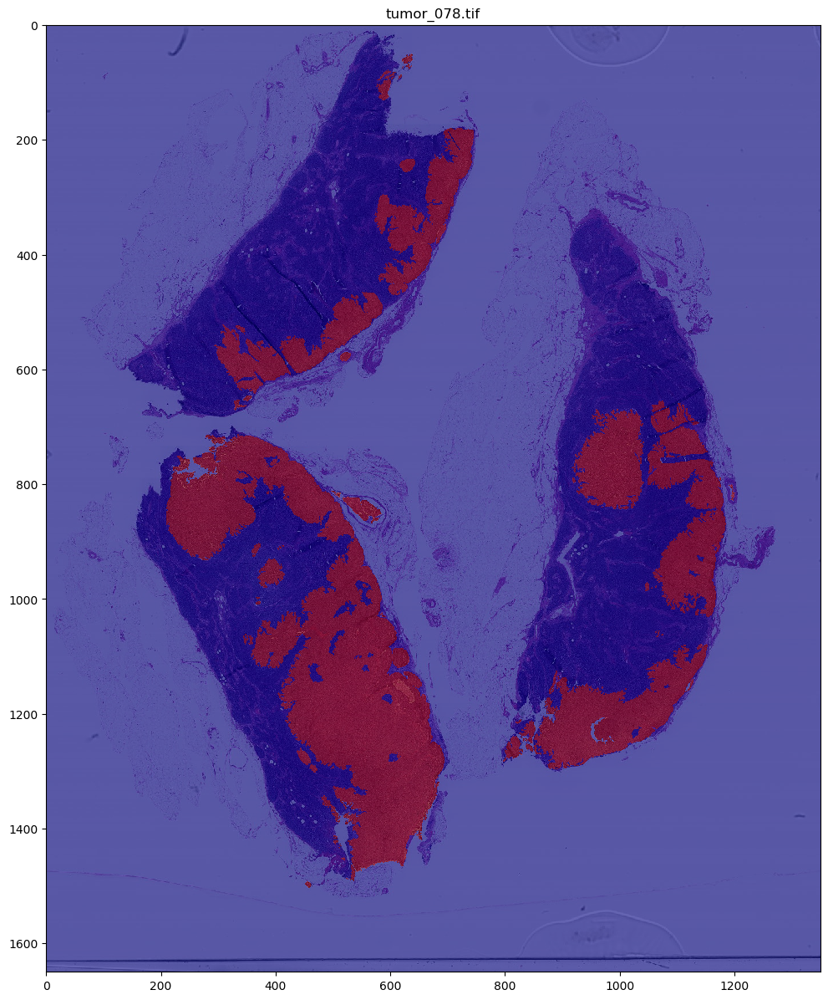

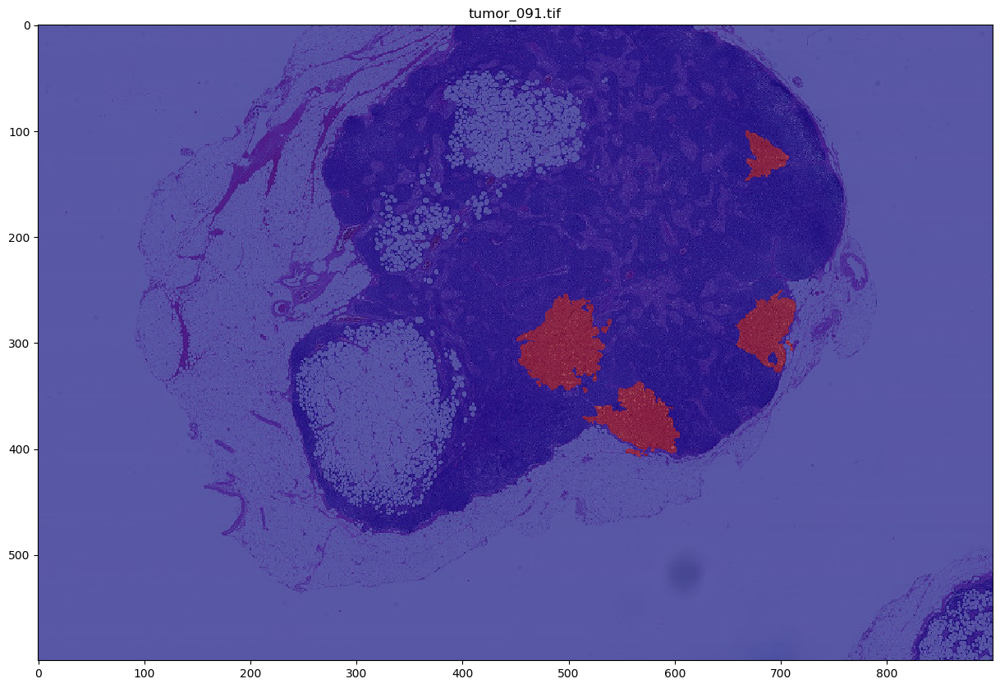

...

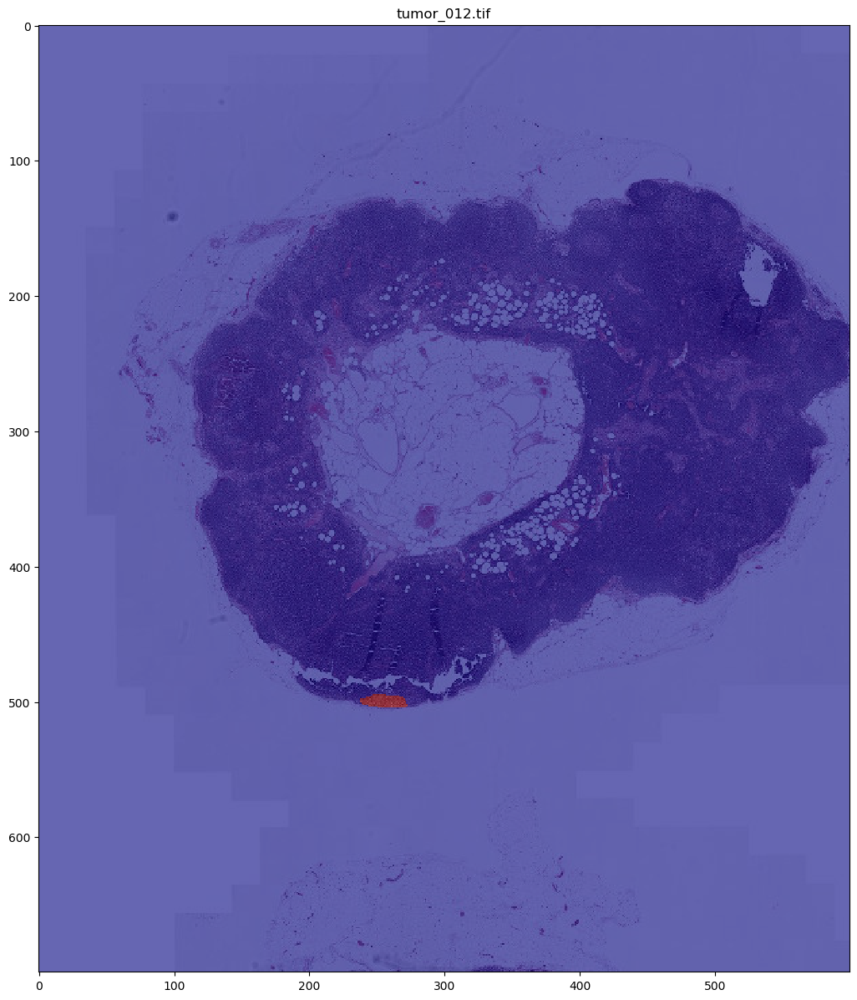

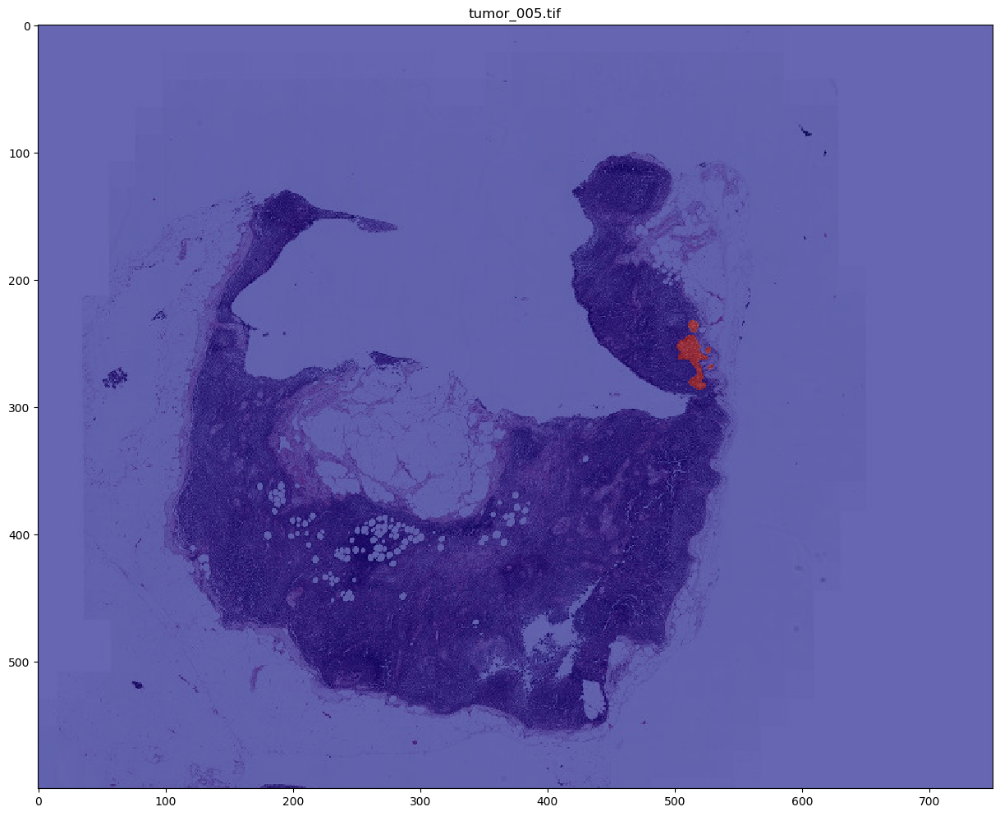

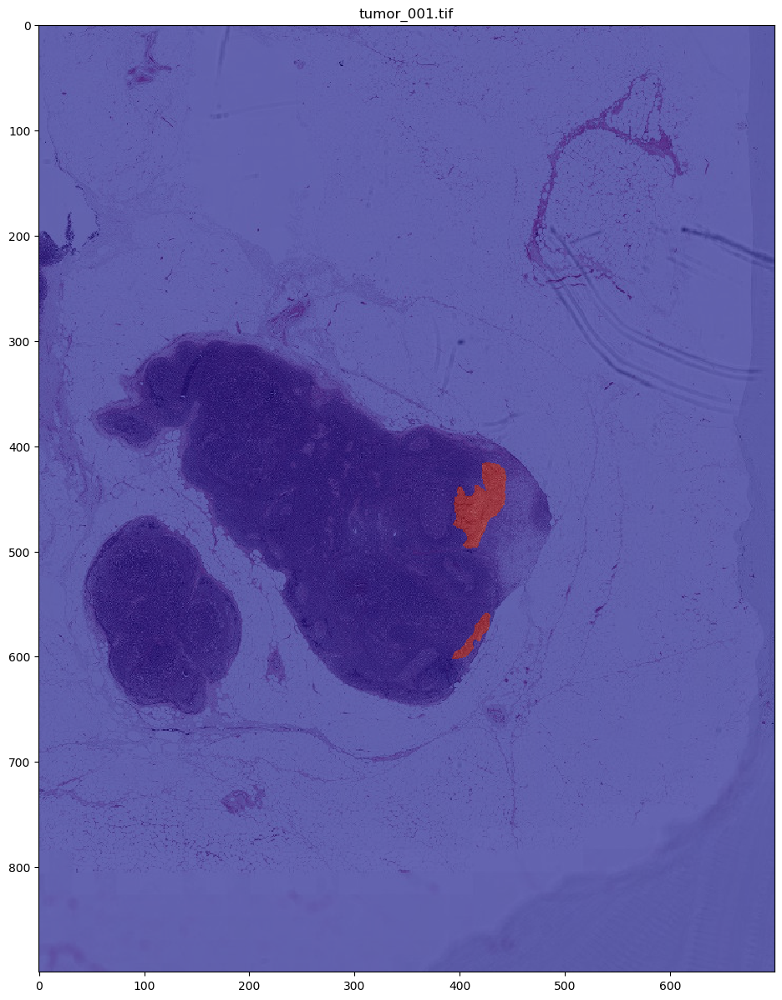

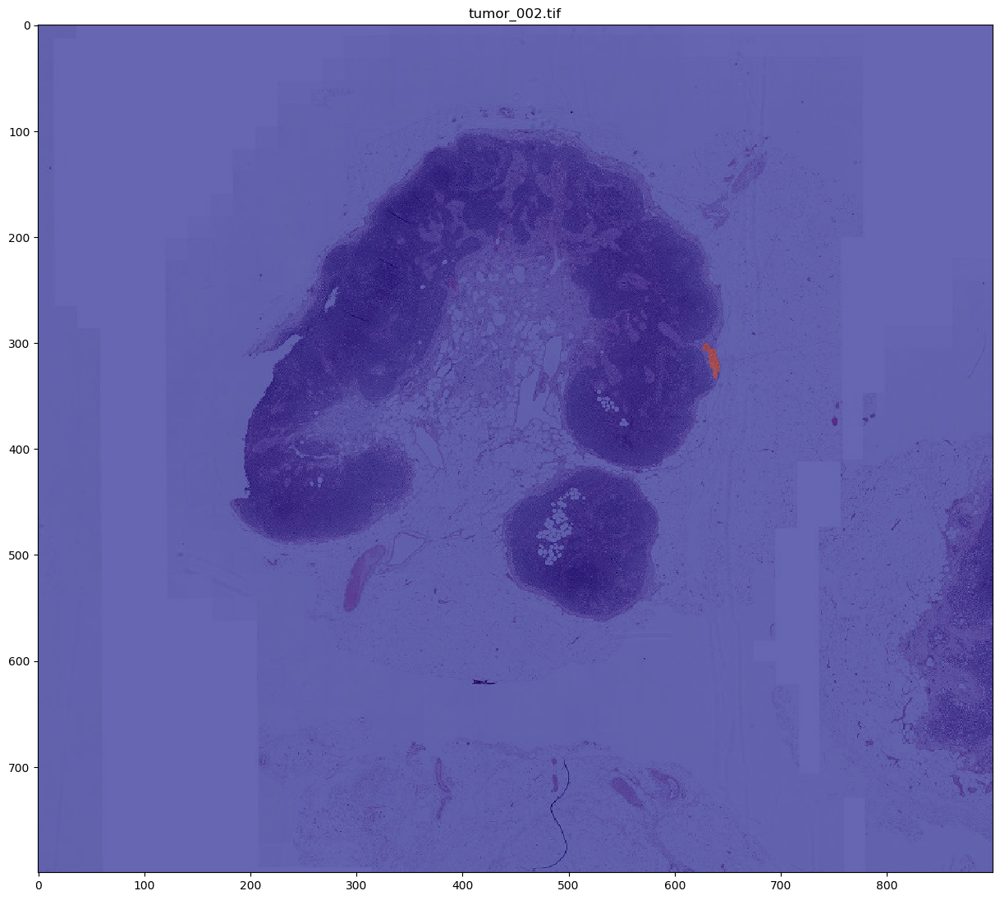

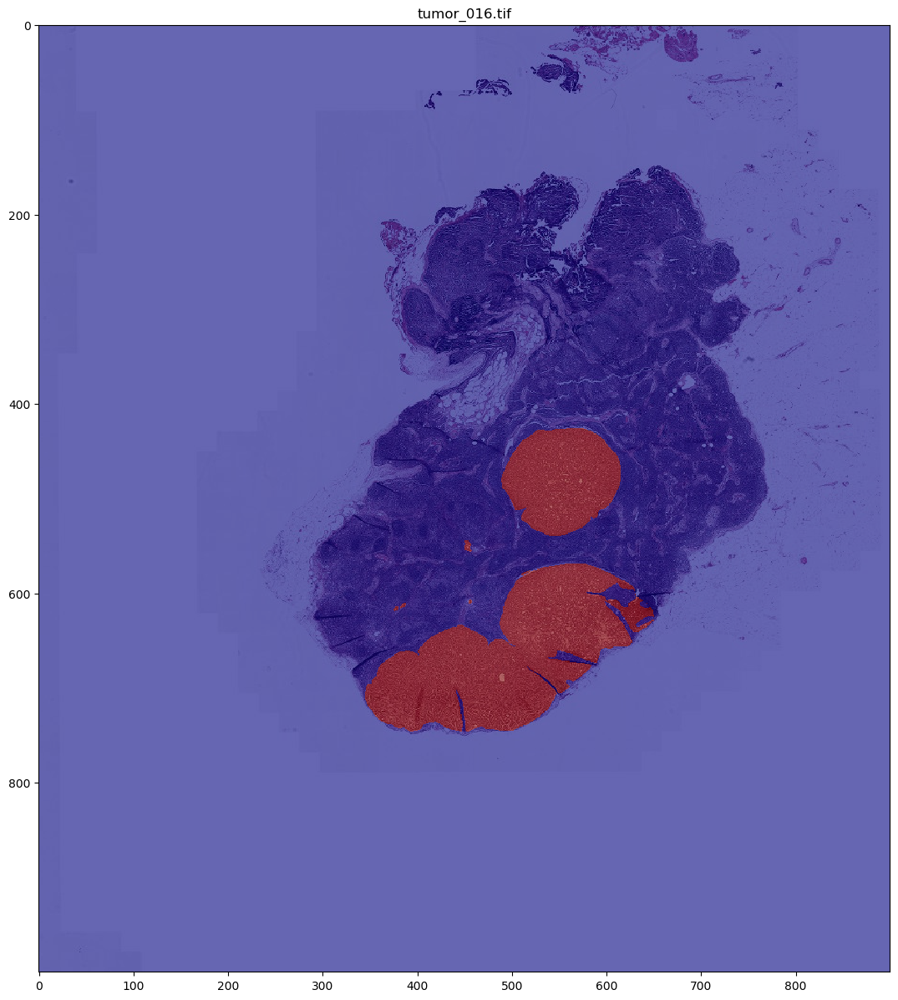

In [461]:
for k,v in slide_selections.items():
    path = root_data_path + k +".tif"
    mask_path = root_data_path + k +"_mask.tif"
    width = v["x"][1]-v["x"][0]
    height = v["y"][1]-v["y"][0]
    
    slide = open_slide(path)
    mask_slide = open_slide(mask_path)
    
    multiplier = int(slide.level_downsamples[6])
    slide_image = read_slide(slide, 
                         x=v["x"][0]*multiplier,y=v["y"][0]*multiplier,
                         level=6,width=width,height=height)   
    mask_image = read_slide(mask_slide, 
                         x=v["x"][0]*multiplier,y=v["y"][0]*multiplier,
                         level=6,width=width,height=height)[:,:,0]
    
    fig = plt.figure(figsize=(15,15), dpi=100)
    plt.title(path.split("/")[-1])
    plt.imshow(slide_image)
    plt.imshow(mask_image, cmap='jet', alpha=.6)

# Image Creation 

Our data pipeline requires jpeg images of each 299X299 patch. The following code cells create this data and save it to disk. 

In [1046]:
"""
Reads a given slide and either saves it to a given filepath or returns it as a numpy array

Parameters:
    slide [slide]: slide object returned from open_slide()
    x [int]: top-left x coordinate to start reading slide from
    y [int]: top-left y coordinate to start reading slide from
    level [int]: zoom level to read slide from
    width [int]: width of output slide
    height [int]: height of output slide 
    file_path [string]: (optional) if provided, function will save the patch to the given file location
Returns:
    Slide patch as a numpy array if no file_path given, otherwise, nothing
"""
def read_slide(slide, x, y, level, width, height, file_path=None):
    im = slide.read_region((x,y), level, (width, height))
    im = im.convert('RGB')
    if file_path:
        im.save(file_path)
    else:
        im = np.asarray(im)
        return im

"""
Converts (x,y) coordinates from one zoom scale to another.

Parameters:
    low_zoom [int]: lower resolution zoom level
    high_zoom [int]: higher resolution zoom level
    xy [(int,int)]: (x,y) coordinates being converted; if low_to_high=true, must be in lower resolution scale; if low_to_true=false, must be in higher resolution scale
    low_to_high [boolean]: if true, function converts given xy coordinates from lower resolution zoom to higher resolution zoom; if false, function converts given xy coordinates from higher resolution zoom to lower resolution zoom; defualt value: true
    bounds [(int,int)]: (optional) lower right coorner (x,y) bounds; if given, if the coordinate conversion result in pixels beyond these p=bounds, an empty array is returned
Returns:
    np.array([int,int]) containing xy coordinates in highest resolution scale
"""
def Convert_Zoom_Level_XY(low_zoom,high_zoom,xy,slide,low_to_high=True,bounds=None):
    xy = np.array([xy[0],xy[1]])
    low_downsample = slide.level_downsamples[low_zoom] # zoom=3
    high_downsample = slide.level_downsamples[high_zoom] # zoom=1
    
    if low_to_high:
        center = (low_downsample*(xy+150)/high_downsample)
        center = center - 150
        high_xy = center*high_downsample
        return high_xy.astype(int)
    # high to low
    else:
        center = (high_downsample*(xy+150)/low_downsample)
        center = center - 150
        low_xy = center*low_downsample
        low_xy = low_xy.astype(int)
        
        x_bound = ((bounds[0]/low_downsample)-299)*low_downsample
        y_bound = ((bounds[1]/low_downsample)-299)*low_downsample
        if (low_xy[0] >= x_bound) or (low_xy[1] >= y_bound) or (low_xy[0] < 0) or (low_xy[1] < 0):
            return np.array([])
        return low_xy 

"""
Determines if image is sufficiently grey

Parameter:
    image [np.array([float])]: image to analyze
    threshold [float]: fraction of pixels which must be grey in order to return true
    intensity [float]: grayscale threshold to be considered a grey pixel
Return:
    boolean: true if image is grey, false otherwise
"""
def Is_Grey(image, threshold=.8, intensity=0.8):
    num_pixels = image.shape[0]*image.shape[1]
    im_gray = rgb2gray(image)
    num_grey_pixels = np.count_nonzero(im_gray >= intensity)
    return True if ((num_grey_pixels/num_pixels) > threshold) else False

"""
Determines if an image is cancerous

Parameters:
    image [np.array([float])]: mask image to analyze
    threshold [float]: fraction of pixels in the center 128X128 region which must be cancerous in order to consider the image cancerous
Returns:
    boolean: true if image is cancerous, false otherwise
"""
def Is_Cancerous(image, threshold=.3):
    image = image[85:214,85:214]
    num_pixels = image.shape[0]*image.shape[1]
    cancerous_pixels = np.count_nonzero(image==1)
    return True if ((cancerous_pixels/num_pixels) > threshold) else False

"""
Builds file path for a given patch

Parameter:
    cancerous [boolean]: true if file path is for cancerous patch, false otherwise
    slide_number [string]: slide number patch is from
    image_number [string]: patch number
    root_data_path [string]: root file path for image data
Returns:
    string: file path for given patch
"""
def Create_Labeled_File_Path(cancerous,slide_number,image_number,root_data_path):
    base_file_path = root_data_path + "/data/level_"
    if cancerous:
        base_file_path += "/cancer/"+ slide_number + "_" + str(image_number)+".jpeg"
    else:
        base_file_path += "/safe/"+ slide_number + "_" + str(image_number)+".jpeg"
    return base_file_path

'\nReads a given slide and either saves it to a given filepath or returns it as a numpy array\n\nParameters:\n    slide [slide]: slide object returned from open_slide()\n    x [int]: top-left x coordinate to start reading slide from\n    y [int]: top-left y coordinate to start reading slide from\n    level [int]: zoom level to read slide from\n    width [int]: width of output slide\n    height [int]: height of output slide \n    file_path [string]: (optional) if provided, function will save the patch to the given file location\nReturns:\n    Slide patch as a numpy array if no file_path given, otherwise, nothing\n'

'\nConverts (x,y) coordinates from one zoom scale to another.\n\nParameters:\n    low_zoom [int]: lower resolution zoom level\n    high_zoom [int]: higher resolution zoom level\n    xy [(int,int)]: (x,y) coordinates being converted; if low_to_high=true, must be in lower resolution scale; if low_to_true=false, must be in higher resolution scale\n    low_to_high [boolean]: if true, function converts given xy coordinates from lower resolution zoom to higher resolution zoom; if false, function converts given xy coordinates from higher resolution zoom to lower resolution zoom; defualt value: true\n    bounds [(int,int)]: (optional) lower right coorner (x,y) bounds; if given, if the coordinate conversion result in pixels beyond these p=bounds, an empty array is returned\nReturns:\n    np.array([int,int]) containing xy coordinates in highest resolution scale\n'

'\nDetermines if image is sufficiently grey\n\nParameter:\n    image [np.array([float])]: image to analyze\n    threshold [float]: fraction of pixels which must be grey in order to return true\n    intensity [float]: grayscale threshold to be considered a grey pixel\nReturn:\n    boolean: true if image is grey, false otherwise\n'

'\nDetermines if an image is cancerous\n\nParameters:\n    image [np.array([float])]: mask image to analyze\n    threshold [float]: fraction of pixels in the center 128X128 region which must be cancerous in order to consider the image cancerous\nReturns:\n    boolean: true if image is cancerous, false otherwise\n'

'\nBuilds file path for a given patch\n\nParameter:\n    cancerous [boolean]: true if file path is for cancerous patch, false otherwise\n    slide_number [string]: slide number patch is from\n    image_number [string]: patch number\n    root_data_path [string]: root file path for image data\nReturns:\n    string: file path for given patch\n'

In [3]:
# bounding coordinates for each slide
slide_selections = { # level 6 coordinates
    "tumor_031":{"x":[400,1200],"y":[2000,2900]},
    "tumor_019":{"x":[600,1200],"y":[900,1700]},
    "tumor_023":{"x":[100,1000],"y":[1600,2400]},
    "tumor_078":{"x":[50,1400],"y":[50,1700]},
    "tumor_091":{"x":[50,950],"y":[200,800]},
    "tumor_084":{"x":[50,1000],"y":[50,1100]},
    "tumor_057":{"x":[50,550],"y":[2100,2700]},
    "tumor_094":{"x":[800,1600],"y":[50,900]},
    "tumor_081":{"x":[300,900],"y":[300,900]},
    "tumor_096":{"x":[50,1100],"y":[50,1100]},
    "tumor_064":{"x":[50,1500],"y":[1500,3000]},
    "tumor_110":{"x":[50,1200],"y":[50,1100]},
    "tumor_075":{"x":[50,850],"y":[500,1100]},
    "tumor_101":{"x":[50,1000],"y":[50,900]},
    "tumor_012":{"x":[500,1100],"y":[700,1400]},
    "tumor_005":{"x":[400,1150],"y":[1900,2500]},
    "tumor_001":{"x":[700,1400],"y":[1500,2400]},
    "tumor_002":{"x":[100,1000],"y":[1300,2100]},
    "tumor_016": {"x":[100,1000],"y":[1900,2900]}
}

In [4]:
stride_size = 128 # x/y stride size for image creation
zoom_levels = [1,2] # zoom levels to create images for
zoom_levels.sort() #ascending
slide_numbers = ["031","078","094","101","016","012"] # slide numbers to create data from
root_data_path = "/Users/Daniel/Downloads/ADL Final Project Data"

# creates folders for data
for zoom_level in zoom_levels:
    file_path = root_data_path + "/data/level_" + str(zoom_level)
    if not os.path.exists(file_path):
        os.makedirs(file_path)
    if not os.path.exists(file_path+"/safe/"):
        os.makedirs(file_path+"/safe/")
    if not os.path.exists(file_path+"/cancer/"):
        os.makedirs(file_path+"/cancer/")

The below script creates 299X299 jpeg files for the given slides
    - Creates a folder for each zoom level
    - Within each zoom level folder, saves images depicting cancerous regions in a "cancer" folder and images not depicting cancerous regions in a "safe" folder
    - Each image's file name is in the form of slide#_image#.jpeg
    - Each image in a zoom level folder has a unique image number
    - Images depicting the same regions but in different zoom levels (resolutions) have the same number (but are in different zoom folders)

File structure:

    root folder/

        level 1/

            cancer/

            safe/

        level 2/

            cancer /

            safe /

            .

            .

            .
    

In [5]:
for slide_number in slide_numbers:
    slide_path = root_data_path + "/slides/tumor_" + slide_number + ".tif"
    mask_path = root_data_path + "/slides/tumor_" + slide_number + "_mask.tif"

    slide_selection = "tumor_" + slide_number
    slide_number = slide_selection.split("_")[1]
    slide = open_slide(slide_path)
    mask_slide = open_slide(mask_path)

    dimensions = slide.level_dimensions
    downsamples = slide.level_downsamples
    highest_zoom = zoom_levels[0]
    lowest_zoom = zoom_levels[-1]
    highest_dimensions = dimensions[highest_zoom]
    lowest_dimensions = dimensions[lowest_zoom]
    highest_downsample = downsamples[highest_zoom]
    lowest_downsample = downsamples[lowest_zoom]

    x1,x2 = slide_selections[slide_selection]["x"]
    y1,y2 = slide_selections[slide_selection]["y"]

    x_start = x1*downsamples[6]/downsamples[highest_zoom]
    y_start = y1*downsamples[6]/downsamples[highest_zoom]

    x_bound = x2*downsamples[6]
    y_bound = y2*downsamples[6]

    x_range = int(((x2-x1)*downsamples[6]/downsamples[highest_zoom])/stride_size)
    y_range = int(((y2-y1)*downsamples[6]/downsamples[highest_zoom])/stride_size)

    bounds= np.array([x_bound,y_bound])

    progress_counter = 0
    print("Slide Number:",slide_number)
    sys.stdout.flush()
    with progressbar.ProgressBar(max_value=(y_range*x_range)) as bar:  
        image_number = 1
        y = y_start-stride_size
        for j in range(y_range):
            y += stride_size # in terms of highest zoom
            x = x_start-stride_size
            for i in range(x_range):
                x += stride_size # in terms of highest zoom

                highest_slide_image = read_slide(slide, 
                                     x=int(x*highest_downsample),y=int(y*highest_downsample),
                                     level=highest_zoom, width=299, height=299)
                highest_mask_image = read_slide(mask_slide, 
                                     x=int(x*highest_downsample),y=int(y*highest_downsample),
                                     level=highest_zoom, width=299, height=299)[:,:,0]

                cancerous = Is_Cancerous(highest_mask_image)
                if Is_Grey(highest_slide_image) and (not cancerous):
                    continue

                base_file_path = Create_Labeled_File_Path(cancerous,slide_number,image_number,root_data_path)

                for zoom_level in zoom_levels[::-1]: # lowest zoom first to make sure all zoom levels will be valid
                    converted_xy = Convert_Zoom_Level_XY(low_zoom=zoom_level, high_zoom=highest_zoom, xy=[x,y], slide=slide, low_to_high=False, bounds=bounds)
                    if converted_xy.size !=0:
                        file_path = base_file_path.replace(("level_"),("level_"+str(zoom_level)))
                        current_slide_image = read_slide(slide, 
                                     x=int(converted_xy[0]),y=int(converted_xy[1]),
                                     level=zoom_level, width=299, height=299,
                                     file_path=file_path)
                    else:
                        image_number -= 1
                        break

                image_number+=1
                bar.update(progress_counter)
                progress_counter+=1

Slide Number: 031


100% (45000 of 45000) |##################| Elapsed Time: 0:04:56 Time:  0:04:56


Slide Number: 078


100% (138844 of 138844) |################| Elapsed Time: 0:23:29 Time:  0:23:29


Slide Number: 094


100% (42400 of 42400) |##################| Elapsed Time: 0:06:46 Time:  0:06:46


Slide Number: 101


100% (50244 of 50244) |##################| Elapsed Time: 0:07:59 Time:  0:07:59


Slide Number: 016


100% (56250 of 56250) |##################| Elapsed Time: 0:07:50 Time:  0:07:50


Slide Number: 012


100% (26250 of 26250) |##################| Elapsed Time: 0:03:42 Time:  0:03:42


# Dataset 

The code cells in this section create tensorflow datasets for training, validation and testing. The datasets can be configured for models using multiple zoom levels or a single zoom level.

In [1133]:
zoom_levels = ["level_1","level_2"]
# zoom_levels = ["level_1"] # zoom levels to create datasets from
zoom_levels.sort()
root_data_path = "/Users/Daniel/Downloads/ADL Final Project Data/data_cancer_value_5/"
labels_dict = {"safe":0,"cancer":1} # target labels
BATCH_SIZE = 256
elements_per_class = 5000 # number of images for each target label (cancerous/safe)
val_proportion = .25 # fraction of data to set aside as validation data
seed = 1234

In [1134]:
"""
Retreives all of the file paths for the training images

Parameters:
    root_path [string]: root file path
    zoom_levels [list(string)]: list of zoom levels to retreive file paths for
    labels_dict [dict{string:int}]: ditionary of target labels
Returns:
    tuple(list(list(string)),list(string)): the first element of the tuple is a list of lists in which the inner lists contain the files paths for images of the zoom levels, 
                                            the second element of the tuple is a list of labels
                                            the indices of both lists match so that index i of the tuple's first list contains the files for an image with a label equal to the value in index i of the tuple's second list
"""
def get_all_zoom_paths(root_path,zoom_levels,labels_dict):
    root_directory = pathlib.Path(root_path)
    single_zoom_paths = list(root_directory.glob(zoom_levels[0]+"/*/*.jpeg"))
    single_zoom_paths = [str(i) for i in single_zoom_paths]
    
    labels = []
    all_zoom_paths = []
    for path in single_zoom_paths:
        label = path.split("/")[-2]
        zoom_paths = []
        for zoom_level in zoom_levels:
            zoom_paths.append(path.replace(zoom_levels[0],zoom_level))
        all_zoom_paths.append(zoom_paths)
        labels.append(labels_dict[label])
    return all_zoom_paths, labels

"""
Converts batches of file path(s)/label pairs into processed image(s)/label pairs

Parameters:
    file_paths_batch [tensor(tensor([string]))]: tensor array containing tensor arrays of image files paths
    label_batch [tensor([int])]: tensor array of labels 
Returns:
    tuple(tensor(tensor([float])),tensor([int]): tensor array containing processed tensor arrays correspondoing to the image files paths and a tensor array of labels
"""
def process_path(file_paths_batch,label_batch):
    if tf.shape(file_paths_batch)[1] > 1:
        images_batch = tf.TensorArray(tf.float32, size=0, dynamic_size=True)  
        for file_paths in file_paths_batch:
            images = tf.TensorArray(tf.float32, size=0, dynamic_size=True)  
            for file_path in file_paths:
                img = tf.io.read_file(file_path)
                img = tf.image.decode_jpeg(img, channels=3)
                img = tf.cast(img,tf.float32)
                img /= 255.0  
                images= images.write(images.size(),img)
            images_batch = images_batch.write(images_batch.size(),images.stack())
        return images_batch.stack(),label_batch
    else:
        images_batch = tf.TensorArray(tf.float32, size=0, dynamic_size=True)  
        for file_path in file_paths_batch:
            img = tf.io.read_file(file_path[0])
            img = tf.image.decode_jpeg(img, channels=3)
            img = tf.cast(img,tf.float32)
            img /= 255.0  
            images_batch = images_batch.write(images_batch.size(),img)
        return images_batch.stack(),label_batch

"\nRetreives all of the file paths for the training images\n\nParameters:\n    root_path [string]: root file path\n    zoom_levels [list(string)]: list of zoom levels to retreive file paths for\n    labels_dict [dict{string:int}]: ditionary of target labels\nReturns:\n    tuple(list(list(string)),list(string)): the first element of the tuple is a list of lists in which the inner lists contain the files paths for images of the zoom levels, \n                                            the second element of the tuple is a list of labels\n                                            the indices of both lists match so that index i of the tuple's first list contains the files for an image with a label equal to the value in index i of the tuple's second list\n"

'\nConverts batches of file path(s)/label pairs into processed image(s)/label pairs\n\nParameters:\n    file_paths_batch [tensor(tensor([string]))]: tensor array containing tensor arrays of image files paths\n    label_batch [tensor([int])]: tensor array of labels \nReturns:\n    tuple(tensor(tensor([float])),tensor([int]): tensor array containing processed tensor arrays correspondoing to the image files paths and a tensor array of labels\n'

In [1135]:
# create train/val/test dataset objects
image_paths, labels = get_all_zoom_paths(root_data_path,zoom_levels,labels_dict)
dataset = tf.data.Dataset.from_tensor_slices((image_paths,labels))
dataset_size = len(list(dataset.as_numpy_iterator()))

safe_dataset = dataset.filter(lambda x,y: y==0).shuffle(dataset_size, reshuffle_each_iteration=False, seed=seed).take(elements_per_class)
cancerous_dataset = dataset.filter(lambda x,y: y==1).shuffle(dataset_size, reshuffle_each_iteration=False, seed=seed).take(elements_per_class)
dataset = safe_dataset.concatenate(cancerous_dataset).shuffle(elements_per_class*2, reshuffle_each_iteration=False, seed=seed)

train_samples = int((1-val_proportion/(val_proportion+1)*2)*elements_per_class*2)
val_samples = int(((elements_per_class*2)-train_samples)/2)
train_ds = dataset.take(train_samples).batch(BATCH_SIZE).map(process_path,num_parallel_calls=tf.data.experimental.AUTOTUNE).cache().prefetch(tf.data.experimental.AUTOTUNE)
val_ds = dataset.skip(train_samples).take(val_samples).batch(BATCH_SIZE).map(process_path,num_parallel_calls=tf.data.experimental.AUTOTUNE).cache().prefetch(tf.data.experimental.AUTOTUNE)
test_ds = dataset.skip(train_samples+val_samples).batch(BATCH_SIZE).map(process_path,num_parallel_calls=tf.data.experimental.AUTOTUNE).cache().prefetch(tf.data.experimental.AUTOTUNE) 

In [1136]:
# assert dataset sizes are correct
assert elements_per_class == len(list(safe_dataset.as_numpy_iterator()))
assert elements_per_class == len(list(cancerous_dataset.as_numpy_iterator()))

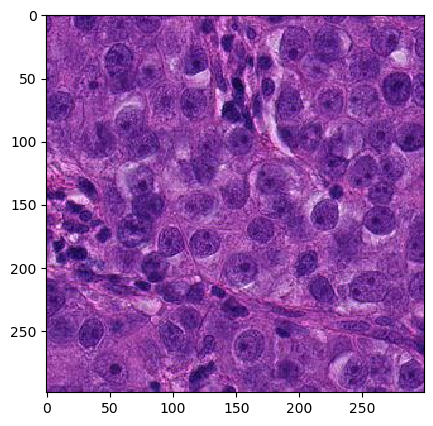

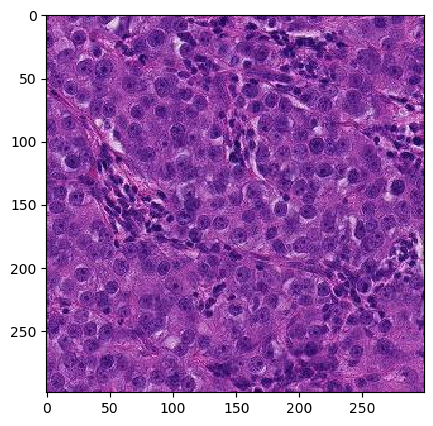

In [1137]:
# print example images
def Print_Train_Sample(ds):
    for i,j in ds.take(1):
        if len(zoom_levels) > 1:
            for n in range(len(zoom_levels)):
                plt.figure(figsize=(5,5), dpi=100)
                plt.imshow(i[0][n])
        else:
            plt.figure(figsize=(5,5), dpi=100)
            plt.imshow(i[0])
        break
Print_Train_Sample(test_ds)

In [1065]:
# report time to iterate through taining dataset
import time
def Time_Dataset_Iteration(train_ds):
    start = time.perf_counter()
    for i,j in train_ds:
        time.sleep(.01)
    print(time.perf_counter()-start)
Time_Dataset_Iteration(train_ds)

11.33621419602423


# Model

## Transfer Learning 

### Train 

#### 1 Zoom

In this section, we trained various model architectures for a dataset containing images of a single resolution

In [611]:
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7"
conv_base = tf.keras.applications.MobileNetV2(include_top=False,weights='imagenet')
conv_base.trainable = False

data_augmentation = tf.keras.Sequential([ 
    tf.keras.layers.experimental.preprocessing.RandomFlip(), 
    tf.keras.layers.experimental.preprocessing.RandomRotation(0.25)
])

inputs = tf.keras.Input(shape=(299,299,3))
# x = data_augmentation(inputs)
x = conv_base(inputs)
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dropout(0.2)(x)
outputs = tf.keras.layers.Dense(1, activation='sigmoid')(x)

metrics = [
      tf.keras.metrics.TruePositives(name='tp'),
      tf.keras.metrics.FalsePositives(name='fp'),
      tf.keras.metrics.TrueNegatives(name='tn'),
      tf.keras.metrics.FalseNegatives(name='fn'), 
      tf.keras.metrics.BinaryAccuracy(name='accuracy'),
      tf.keras.metrics.Precision(name='precision'),
      tf.keras.metrics.Recall(name='recall'),
      tf.keras.metrics.AUC(name='auc'),
      tf.keras.metrics.AUC(name='prc', curve='PR')
]

model = tf.keras.Model(inputs, outputs) 
model.compile(loss='binary_crossentropy',optimizer='rmsprop', metrics=metrics)
model.summary()

Model: "model_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_70 (InputLayer)        [(None, 299, 299, 3)]     0         
_________________________________________________________________
mobilenetv2_1.00_224 (Functi (None, None, None, 1280)  2257984   
_________________________________________________________________
global_average_pooling2d_32  (None, 1280)              0         
_________________________________________________________________
dropout_32 (Dropout)         (None, 1280)              0         
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 1281      
Total params: 2,259,265
Trainable params: 1,281
Non-trainable params: 2,257,984
_________________________________________________________________


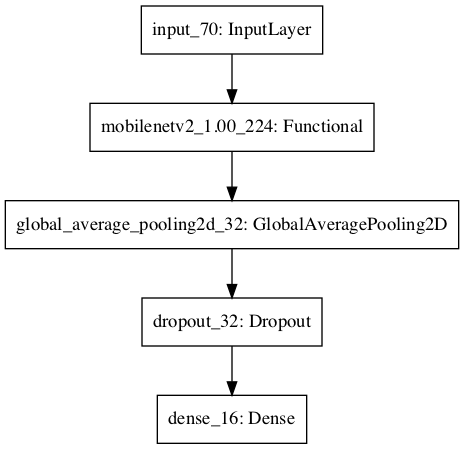

In [1051]:
plot_model(model)

In [612]:
# logs_path = model_path + "/logs/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
# tboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logs_path,histogram_freq = 1,profile_batch = '2,9')

early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', 
    patience=5,
    restore_best_weights=True)
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
    filepath=model_path, 
    save_best_only=True, 
    monitor='val_loss')

callbacks = [early_stopping, model_checkpoint]

model.fit(train_ds,validation_data=val_ds,epochs=30,callbacks=callbacks)

Epoch 1/30
24/24 [==============================] - 213s 8s/step - loss: 0.5280 - tp: 1219.5200 - fp: 238.8000 - tn: 1433.7200 - fn: 414.2000 - accuracy: 0.7621 - precision: 0.7953 - recall: 0.6566 - auc: 0.8194 - prc: 0.8267 - val_loss: 0.2491 - val_tp: 924.0000 - val_fp: 47.0000 - val_tn: 941.0000 - val_fn: 88.0000 - val_accuracy: 0.9325 - val_precision: 0.9516 - val_recall: 0.9130 - val_auc: 0.9780 - val_prc: 0.9820


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 2/30
24/24 [==============================] - 198s 8s/step - loss: 0.2301 - tp: 1507.4400 - fp: 108.9200 - tn: 1563.6000 - fn: 126.2800 - accuracy: 0.9304 - precision: 0.9348 - recall: 0.9222 - auc: 0.9788 - prc: 0.9807 - val_loss: 0.1823 - val_tp: 937.0000 - val_fp: 39.0000 - val_tn: 949.0000 - val_fn: 75.0000 - val_accuracy: 0.9430 - val_precision: 0.9600 - val_recall: 0.9259 - val_auc: 0.9841 - val_prc: 0.9866


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 3/30
24/24 [==============================] - 211s 9s/step - loss: 0.1723 - tp: 1520.9600 - fp: 91.0800 - tn: 1581.4400 - fn: 112.7600 - accuracy: 0.9415 - precision: 0.9470 - recall: 0.9329 - auc: 0.9850 - prc: 0.9867 - val_loss: 0.1572 - val_tp: 939.0000 - val_fp: 32.0000 - val_tn: 956.0000 - val_fn: 73.0000 - val_accuracy: 0.9475 - val_precision: 0.9670 - val_recall: 0.9279 - val_auc: 0.9867 - val_prc: 0.9887


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 4/30
24/24 [==============================] - 192s 8s/step - loss: 0.1473 - tp: 1529.7200 - fp: 77.1600 - tn: 1595.3600 - fn: 104.0000 - accuracy: 0.9478 - precision: 0.9560 - recall: 0.9365 - auc: 0.9874 - prc: 0.9887 - val_loss: 0.1420 - val_tp: 945.0000 - val_fp: 32.0000 - val_tn: 956.0000 - val_fn: 67.0000 - val_accuracy: 0.9505 - val_precision: 0.9672 - val_recall: 0.9338 - val_auc: 0.9883 - val_prc: 0.9901


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 5/30
24/24 [==============================] - 202s 8s/step - loss: 0.1379 - tp: 1539.4400 - fp: 68.7200 - tn: 1603.8000 - fn: 94.2800 - accuracy: 0.9526 - precision: 0.9584 - recall: 0.9441 - auc: 0.9885 - prc: 0.9896 - val_loss: 0.1334 - val_tp: 949.0000 - val_fp: 33.0000 - val_tn: 955.0000 - val_fn: 63.0000 - val_accuracy: 0.9520 - val_precision: 0.9664 - val_recall: 0.9377 - val_auc: 0.9892 - val_prc: 0.9908


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 6/30
24/24 [==============================] - 195s 8s/step - loss: 0.1238 - tp: 1541.7200 - fp: 62.9600 - tn: 1609.5600 - fn: 92.0000 - accuracy: 0.9569 - precision: 0.9645 - recall: 0.9470 - auc: 0.9907 - prc: 0.9919 - val_loss: 0.1270 - val_tp: 954.0000 - val_fp: 34.0000 - val_tn: 954.0000 - val_fn: 58.0000 - val_accuracy: 0.9540 - val_precision: 0.9656 - val_recall: 0.9427 - val_auc: 0.9899 - val_prc: 0.9915


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 7/30
24/24 [==============================] - 215s 9s/step - loss: 0.1185 - tp: 1548.0400 - fp: 58.1600 - tn: 1614.3600 - fn: 85.6800 - accuracy: 0.9608 - precision: 0.9686 - recall: 0.9511 - auc: 0.9912 - prc: 0.9920 - val_loss: 0.1233 - val_tp: 953.0000 - val_fp: 30.0000 - val_tn: 958.0000 - val_fn: 59.0000 - val_accuracy: 0.9555 - val_precision: 0.9695 - val_recall: 0.9417 - val_auc: 0.9905 - val_prc: 0.9920


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 8/30
24/24 [==============================] - 208s 9s/step - loss: 0.1184 - tp: 1550.2800 - fp: 57.8000 - tn: 1614.7200 - fn: 83.4400 - accuracy: 0.9596 - precision: 0.9671 - recall: 0.9500 - auc: 0.9908 - prc: 0.9919 - val_loss: 0.1191 - val_tp: 955.0000 - val_fp: 30.0000 - val_tn: 958.0000 - val_fn: 57.0000 - val_accuracy: 0.9565 - val_precision: 0.9695 - val_recall: 0.9437 - val_auc: 0.9910 - val_prc: 0.9924


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 9/30
24/24 [==============================] - 206s 9s/step - loss: 0.1106 - tp: 1551.6400 - fp: 52.8000 - tn: 1619.7200 - fn: 82.0800 - accuracy: 0.9617 - precision: 0.9689 - recall: 0.9525 - auc: 0.9918 - prc: 0.9927 - val_loss: 0.1164 - val_tp: 957.0000 - val_fp: 30.0000 - val_tn: 958.0000 - val_fn: 55.0000 - val_accuracy: 0.9575 - val_precision: 0.9696 - val_recall: 0.9457 - val_auc: 0.9914 - val_prc: 0.9927


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 10/30
24/24 [==============================] - 199s 8s/step - loss: 0.1098 - tp: 1550.4800 - fp: 54.4800 - tn: 1618.0400 - fn: 83.2400 - accuracy: 0.9603 - precision: 0.9678 - recall: 0.9507 - auc: 0.9923 - prc: 0.9930 - val_loss: 0.1163 - val_tp: 950.0000 - val_fp: 24.0000 - val_tn: 964.0000 - val_fn: 62.0000 - val_accuracy: 0.9570 - val_precision: 0.9754 - val_recall: 0.9387 - val_auc: 0.9917 - val_prc: 0.9930


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 11/30
24/24 [==============================] - 204s 8s/step - loss: 0.1082 - tp: 1551.8800 - fp: 51.3200 - tn: 1621.2000 - fn: 81.8400 - accuracy: 0.9621 - precision: 0.9710 - recall: 0.9511 - auc: 0.9922 - prc: 0.9933 - val_loss: 0.1110 - val_tp: 962.0000 - val_fp: 32.0000 - val_tn: 956.0000 - val_fn: 50.0000 - val_accuracy: 0.9590 - val_precision: 0.9678 - val_recall: 0.9506 - val_auc: 0.9920 - val_prc: 0.9932


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 12/30
24/24 [==============================] - 208s 9s/step - loss: 0.1015 - tp: 1561.6000 - fp: 51.6800 - tn: 1620.8400 - fn: 72.1200 - accuracy: 0.9659 - precision: 0.9704 - recall: 0.9598 - auc: 0.9928 - prc: 0.9939 - val_loss: 0.1104 - val_tp: 956.0000 - val_fp: 26.0000 - val_tn: 962.0000 - val_fn: 56.0000 - val_accuracy: 0.9590 - val_precision: 0.9735 - val_recall: 0.9447 - val_auc: 0.9922 - val_prc: 0.9933


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 13/30
24/24 [==============================] - 209s 9s/step - loss: 0.1029 - tp: 1560.8800 - fp: 55.5600 - tn: 1616.9600 - fn: 72.8400 - accuracy: 0.9631 - precision: 0.9660 - recall: 0.9585 - auc: 0.9927 - prc: 0.9938 - val_loss: 0.1087 - val_tp: 957.0000 - val_fp: 26.0000 - val_tn: 962.0000 - val_fn: 55.0000 - val_accuracy: 0.9595 - val_precision: 0.9736 - val_recall: 0.9457 - val_auc: 0.9923 - val_prc: 0.9935


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 14/30
24/24 [==============================] - 202s 8s/step - loss: 0.1019 - tp: 1558.2800 - fp: 50.1600 - tn: 1622.3600 - fn: 75.4400 - accuracy: 0.9641 - precision: 0.9703 - recall: 0.9559 - auc: 0.9928 - prc: 0.9937 - val_loss: 0.1097 - val_tp: 955.0000 - val_fp: 19.0000 - val_tn: 969.0000 - val_fn: 57.0000 - val_accuracy: 0.9620 - val_precision: 0.9805 - val_recall: 0.9437 - val_auc: 0.9925 - val_prc: 0.9936
Epoch 15/30
24/24 [==============================] - 208s 9s/step - loss: 0.1010 - tp: 1558.6000 - fp: 49.0400 - tn: 1623.4800 - fn: 75.1200 - accuracy: 0.9645 - precision: 0.9722 - recall: 0.9549 - auc: 0.9932 - prc: 0.9940 - val_loss: 0.1061 - val_tp: 958.0000 - val_fp: 22.0000 - val_tn: 966.0000 - val_fn: 54.0000 - val_accuracy: 0.9620 - val_precision: 0.9776 - val_recall: 0.9466 - val_auc: 0.9927 - val_prc: 0.9938


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 16/30
24/24 [==============================] - 207s 9s/step - loss: 0.0986 - tp: 1560.6400 - fp: 50.2400 - tn: 1622.2800 - fn: 73.0800 - accuracy: 0.9642 - precision: 0.9706 - recall: 0.9559 - auc: 0.9934 - prc: 0.9941 - val_loss: 0.1035 - val_tp: 961.0000 - val_fp: 24.0000 - val_tn: 964.0000 - val_fn: 51.0000 - val_accuracy: 0.9625 - val_precision: 0.9756 - val_recall: 0.9496 - val_auc: 0.9930 - val_prc: 0.9940


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 17/30
24/24 [==============================] - 204s 8s/step - loss: 0.0963 - tp: 1559.4400 - fp: 45.1600 - tn: 1627.3600 - fn: 74.2800 - accuracy: 0.9667 - precision: 0.9741 - recall: 0.9577 - auc: 0.9936 - prc: 0.9945 - val_loss: 0.1044 - val_tp: 957.0000 - val_fp: 20.0000 - val_tn: 968.0000 - val_fn: 55.0000 - val_accuracy: 0.9625 - val_precision: 0.9795 - val_recall: 0.9457 - val_auc: 0.9932 - val_prc: 0.9941
Epoch 18/30
24/24 [==============================] - 216s 9s/step - loss: 0.0925 - tp: 1559.2000 - fp: 44.9600 - tn: 1627.5600 - fn: 74.5200 - accuracy: 0.9665 - precision: 0.9751 - recall: 0.9562 - auc: 0.9943 - prc: 0.9950 - val_loss: 0.1012 - val_tp: 965.0000 - val_fp: 28.0000 - val_tn: 960.0000 - val_fn: 47.0000 - val_accuracy: 0.9625 - val_precision: 0.9718 - val_recall: 0.9536 - val_auc: 0.9932 - val_prc: 0.9942


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 19/30
24/24 [==============================] - 216s 9s/step - loss: 0.0921 - tp: 1569.2000 - fp: 45.8800 - tn: 1626.6400 - fn: 64.5200 - accuracy: 0.9684 - precision: 0.9730 - recall: 0.9620 - auc: 0.9942 - prc: 0.9950 - val_loss: 0.1017 - val_tp: 962.0000 - val_fp: 22.0000 - val_tn: 966.0000 - val_fn: 50.0000 - val_accuracy: 0.9640 - val_precision: 0.9776 - val_recall: 0.9506 - val_auc: 0.9934 - val_prc: 0.9943
Epoch 20/30
24/24 [==============================] - 201s 8s/step - loss: 0.0931 - tp: 1563.8000 - fp: 46.5200 - tn: 1626.0000 - fn: 69.9200 - accuracy: 0.9670 - precision: 0.9727 - recall: 0.9596 - auc: 0.9938 - prc: 0.9946 - val_loss: 0.1000 - val_tp: 964.0000 - val_fp: 25.0000 - val_tn: 963.0000 - val_fn: 48.0000 - val_accuracy: 0.9635 - val_precision: 0.9747 - val_recall: 0.9526 - val_auc: 0.9934 - val_prc: 0.9943


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 21/30
24/24 [==============================] - 209s 9s/step - loss: 0.0913 - tp: 1571.9200 - fp: 44.8400 - tn: 1627.6800 - fn: 61.8000 - accuracy: 0.9703 - precision: 0.9742 - recall: 0.9649 - auc: 0.9942 - prc: 0.9947 - val_loss: 0.0989 - val_tp: 964.0000 - val_fp: 25.0000 - val_tn: 963.0000 - val_fn: 48.0000 - val_accuracy: 0.9635 - val_precision: 0.9747 - val_recall: 0.9526 - val_auc: 0.9936 - val_prc: 0.9945


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 22/30
24/24 [==============================] - 205s 8s/step - loss: 0.0893 - tp: 1567.1600 - fp: 46.8000 - tn: 1625.7200 - fn: 66.5600 - accuracy: 0.9665 - precision: 0.9710 - recall: 0.9601 - auc: 0.9946 - prc: 0.9949 - val_loss: 0.1005 - val_tp: 962.0000 - val_fp: 20.0000 - val_tn: 968.0000 - val_fn: 50.0000 - val_accuracy: 0.9650 - val_precision: 0.9796 - val_recall: 0.9506 - val_auc: 0.9937 - val_prc: 0.9946
Epoch 23/30
24/24 [==============================] - 207s 9s/step - loss: 0.0868 - tp: 1567.5200 - fp: 44.0400 - tn: 1628.4800 - fn: 66.2000 - accuracy: 0.9688 - precision: 0.9758 - recall: 0.9602 - auc: 0.9947 - prc: 0.9953 - val_loss: 0.0996 - val_tp: 963.0000 - val_fp: 21.0000 - val_tn: 967.0000 - val_fn: 49.0000 - val_accuracy: 0.9650 - val_precision: 0.9787 - val_recall: 0.9516 - val_auc: 0.9937 - val_prc: 0.9945
Epoch 24/30
24/24 [=============

/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 26/30
24/24 [==============================] - 212s 9s/step - loss: 0.0887 - tp: 1568.0800 - fp: 43.3200 - tn: 1629.2000 - fn: 65.6400 - accuracy: 0.9695 - precision: 0.9765 - recall: 0.9610 - auc: 0.9946 - prc: 0.9950 - val_loss: 0.0972 - val_tp: 967.0000 - val_fp: 22.0000 - val_tn: 966.0000 - val_fn: 45.0000 - val_accuracy: 0.9665 - val_precision: 0.9778 - val_recall: 0.9555 - val_auc: 0.9938 - val_prc: 0.9947


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 27/30
24/24 [==============================] - 207s 9s/step - loss: 0.0830 - tp: 1571.9600 - fp: 43.1200 - tn: 1629.4000 - fn: 61.7600 - accuracy: 0.9709 - precision: 0.9757 - recall: 0.9647 - auc: 0.9953 - prc: 0.9955 - val_loss: 0.0960 - val_tp: 968.0000 - val_fp: 23.0000 - val_tn: 965.0000 - val_fn: 44.0000 - val_accuracy: 0.9665 - val_precision: 0.9768 - val_recall: 0.9565 - val_auc: 0.9939 - val_prc: 0.9947


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 28/30
24/24 [==============================] - 237s 10s/step - loss: 0.0872 - tp: 1565.8800 - fp: 42.4400 - tn: 1630.0800 - fn: 67.8400 - accuracy: 0.9682 - precision: 0.9764 - recall: 0.9583 - auc: 0.9947 - prc: 0.9952 - val_loss: 0.0951 - val_tp: 968.0000 - val_fp: 23.0000 - val_tn: 965.0000 - val_fn: 44.0000 - val_accuracy: 0.9665 - val_precision: 0.9768 - val_recall: 0.9565 - val_auc: 0.9940 - val_prc: 0.9948


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7/assets
Epoch 29/30
24/24 [==============================] - 222s 9s/step - loss: 0.0859 - tp: 1570.5200 - fp: 42.9600 - tn: 1629.5600 - fn: 63.2000 - accuracy: 0.9688 - precision: 0.9744 - recall: 0.9615 - auc: 0.9951 - prc: 0.9956 - val_loss: 0.0954 - val_tp: 967.0000 - val_fp: 21.0000 - val_tn: 967.0000 - val_fn: 45.0000 - val_accuracy: 0.9670 - val_precision: 0.9787 - val_recall: 0.9555 - val_auc: 0.9941 - val_prc: 0.9948
Epoch 30/30
24/24 [==============================] - 207s 9s/step - loss: 0.0863 - tp: 1564.3200 - fp: 45.6400 - tn: 1626.8800 - fn: 69.4000 - accuracy: 0.9667 - precision: 0.9729 - recall: 0.9588 - auc: 0.9950 - prc: 0.9954 - val_loss: 0.0963 - val_tp: 967.0000 - val_fp: 21.0000 - val_tn: 967.0000 - val_fn: 45.0000 - val_accuracy: 0.9670 - val_precision: 0.9787 - val_recall: 0.9555 - val_auc: 0.9940 - val_prc: 0.9948


In [613]:
model.evaluate(test_ds)

8/8 [==============================] - 57s 6s/step - loss: 0.0955 - tp: 976.0000 - fp: 22.0000 - tn: 953.0000 - fn: 49.0000 - accuracy: 0.9645 - precision: 0.9780 - recall: 0.9522 - auc: 0.9945 - prc: 0.9953


[0.09549198299646378,
 976.0,
 22.0,
 953.0,
 49.0,
 0.9645000100135803,
 0.9779559373855591,
 0.9521951079368591,
 0.9944920539855957,
 0.995344340801239]

#### 2 Zoom

In this section, we trained various model architectures for a dataset containing images of a two resolutions

In [251]:
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6"
conv_base_1 = tf.keras.applications.MobileNetV2(include_top=False,weights='imagenet')
conv_base_1._name = "conv_1"
conv_base_1.trainable = False

conv_base_2 = tf.keras.applications.MobileNetV2(include_top=False,weights='imagenet')
conv_base_2._name = "conv_2"
conv_base_2.trainable = False

inputs = tf.keras.Input(shape=(2,299,299,3))

x_1 = tf.keras.layers.Cropping3D(cropping=((0,1),(0,0),(0,0)))(inputs)
x_1 = tf.squeeze(x_1,[1])
x_1 = conv_base_1(x_1) 
x_1 = tf.keras.layers.GlobalAveragePooling2D()(x_1)
x_1 = tf.keras.layers.Dropout(0.2)(x_1)

x_2 = tf.keras.layers.Cropping3D(cropping=((1,0),(0,0),(0,0)))(inputs)
x_2 = tf.squeeze(x_2,[1])
x_2 = conv_base_2(x_2)
x_2 = tf.keras.layers.GlobalAveragePooling2D()(x_2)
x_2 = tf.keras.layers.Dropout(0.2)(x_2)

x_3 = tf.keras.layers.concatenate([x_1,x_2])

outputs = tf.keras.layers.Dense(1, activation='sigmoid')(x_3)

metrics = [
      tf.keras.metrics.TruePositives(name='tp'),
      tf.keras.metrics.FalsePositives(name='fp'),
      tf.keras.metrics.TrueNegatives(name='tn'),
      tf.keras.metrics.FalseNegatives(name='fn'), 
      tf.keras.metrics.BinaryAccuracy(name='accuracy'),
      tf.keras.metrics.Precision(name='precision'),
      tf.keras.metrics.Recall(name='recall'),
      tf.keras.metrics.AUC(name='auc'),
      tf.keras.metrics.AUC(name='prc', curve='PR')
]

model = tf.keras.Model(inputs, outputs) 
model.compile(loss='binary_crossentropy',optimizer='rmsprop', metrics=metrics)
model.summary()

Model: "model_15"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_68 (InputLayer)           [(None, 2, 299, 299, 0                                            
__________________________________________________________________________________________________
cropping3d_35 (Cropping3D)      (None, 1, 299, 299,  0           input_68[0][0]                   
__________________________________________________________________________________________________
cropping3d_36 (Cropping3D)      (None, 1, 299, 299,  0           input_68[0][0]                   
__________________________________________________________________________________________________
tf.compat.v1.squeeze_2 (TFOpLam (None, 299, 299, 3)  0           cropping3d_35[0][0]              
___________________________________________________________________________________________

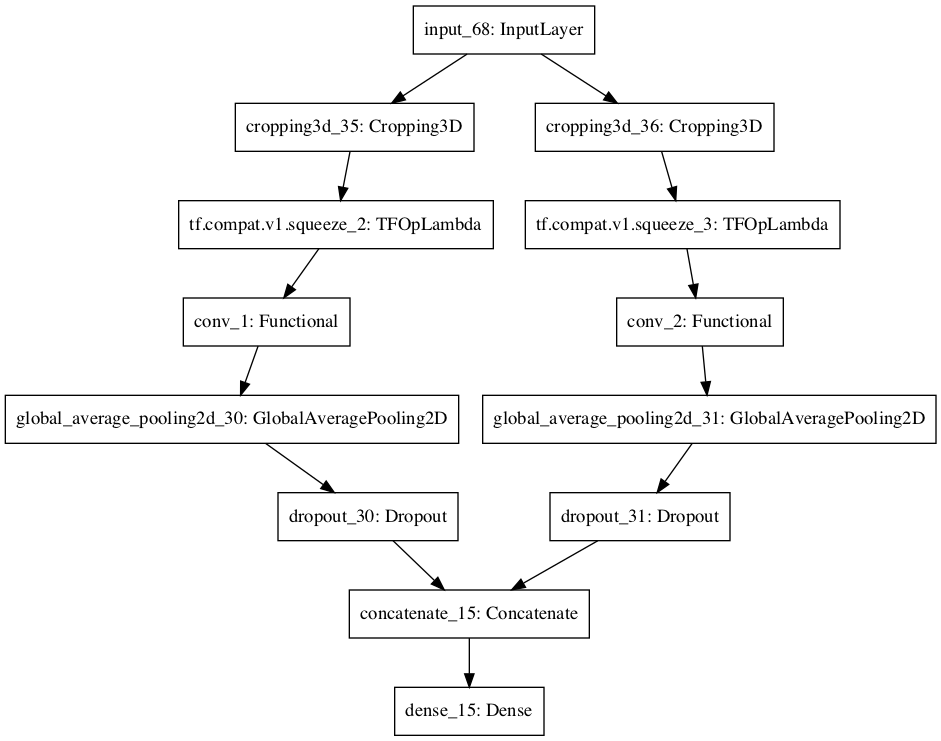

In [252]:
plot_model(model)

In [253]:
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', 
    patience=5,
    restore_best_weights=True)
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
    filepath=model_path, 
    save_best_only=True, 
    monitor='val_loss')
callbacks = [early_stopping, model_checkpoint]
model.fit(train_ds,validation_data=val_ds,epochs=30,callbacks=callbacks)

Epoch 1/30
24/24 [==============================] - 560s 22s/step - loss: 0.4357 - tp: 1345.0800 - fp: 279.4000 - tn: 1398.0400 - fn: 283.7200 - accuracy: 0.7793 - precision: 0.7742 - recall: 0.7739 - auc: 0.8608 - prc: 0.8666 - val_loss: 0.1695 - val_tp: 947.0000 - val_fp: 65.0000 - val_tn: 939.0000 - val_fn: 49.0000 - val_accuracy: 0.9430 - val_precision: 0.9358 - val_recall: 0.9508 - val_auc: 0.9864 - val_prc: 0.9888


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 2/30
24/24 [==============================] - 429s 18s/step - loss: 0.1634 - tp: 1534.7600 - fp: 90.5200 - tn: 1586.9200 - fn: 94.0400 - accuracy: 0.9435 - precision: 0.9413 - recall: 0.9434 - auc: 0.9870 - prc: 0.9871 - val_loss: 0.1265 - val_tp: 957.0000 - val_fp: 42.0000 - val_tn: 962.0000 - val_fn: 39.0000 - val_accuracy: 0.9595 - val_precision: 0.9580 - val_recall: 0.9608 - val_auc: 0.9896 - val_prc: 0.9917


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 3/30
24/24 [==============================] - 414s 17s/step - loss: 0.1199 - tp: 1565.9600 - fp: 74.4000 - tn: 1603.0400 - fn: 62.8400 - accuracy: 0.9582 - precision: 0.9525 - recall: 0.9627 - auc: 0.9920 - prc: 0.9920 - val_loss: 0.1118 - val_tp: 958.0000 - val_fp: 37.0000 - val_tn: 967.0000 - val_fn: 38.0000 - val_accuracy: 0.9625 - val_precision: 0.9628 - val_recall: 0.9618 - val_auc: 0.9910 - val_prc: 0.9926


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 4/30
24/24 [==============================] - 392s 16s/step - loss: 0.1027 - tp: 1568.5200 - fp: 67.0800 - tn: 1610.3600 - fn: 60.2800 - accuracy: 0.9623 - precision: 0.9590 - recall: 0.9642 - auc: 0.9937 - prc: 0.9939 - val_loss: 0.1046 - val_tp: 964.0000 - val_fp: 37.0000 - val_tn: 967.0000 - val_fn: 32.0000 - val_accuracy: 0.9655 - val_precision: 0.9630 - val_recall: 0.9679 - val_auc: 0.9918 - val_prc: 0.9932


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 5/30
24/24 [==============================] - 446s 19s/step - loss: 0.0923 - tp: 1569.0000 - fp: 57.8800 - tn: 1619.5600 - fn: 59.8000 - accuracy: 0.9651 - precision: 0.9636 - recall: 0.9652 - auc: 0.9949 - prc: 0.9950 - val_loss: 0.1026 - val_tp: 971.0000 - val_fp: 41.0000 - val_tn: 963.0000 - val_fn: 25.0000 - val_accuracy: 0.9670 - val_precision: 0.9595 - val_recall: 0.9749 - val_auc: 0.9916 - val_prc: 0.9916


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 6/30
24/24 [==============================] - 417s 18s/step - loss: 0.0885 - tp: 1572.0400 - fp: 54.2000 - tn: 1623.2400 - fn: 56.7600 - accuracy: 0.9665 - precision: 0.9650 - recall: 0.9668 - auc: 0.9952 - prc: 0.9952 - val_loss: 0.0968 - val_tp: 968.0000 - val_fp: 32.0000 - val_tn: 972.0000 - val_fn: 28.0000 - val_accuracy: 0.9700 - val_precision: 0.9680 - val_recall: 0.9719 - val_auc: 0.9922 - val_prc: 0.9919


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 7/30
24/24 [==============================] - 408s 17s/step - loss: 0.0818 - tp: 1577.3600 - fp: 51.5200 - tn: 1625.9200 - fn: 51.4400 - accuracy: 0.9694 - precision: 0.9672 - recall: 0.9705 - auc: 0.9958 - prc: 0.9959 - val_loss: 0.0936 - val_tp: 968.0000 - val_fp: 32.0000 - val_tn: 972.0000 - val_fn: 28.0000 - val_accuracy: 0.9700 - val_precision: 0.9680 - val_recall: 0.9719 - val_auc: 0.9927 - val_prc: 0.9923


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 8/30
24/24 [==============================] - 428s 18s/step - loss: 0.0775 - tp: 1582.1200 - fp: 46.3600 - tn: 1631.0800 - fn: 46.6800 - accuracy: 0.9727 - precision: 0.9710 - recall: 0.9734 - auc: 0.9962 - prc: 0.9961 - val_loss: 0.0921 - val_tp: 970.0000 - val_fp: 33.0000 - val_tn: 971.0000 - val_fn: 26.0000 - val_accuracy: 0.9705 - val_precision: 0.9671 - val_recall: 0.9739 - val_auc: 0.9930 - val_prc: 0.9926


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 9/30
24/24 [==============================] - 387s 16s/step - loss: 0.0733 - tp: 1584.3200 - fp: 46.9200 - tn: 1630.5200 - fn: 44.4800 - accuracy: 0.9728 - precision: 0.9704 - recall: 0.9742 - auc: 0.9968 - prc: 0.9969 - val_loss: 0.0885 - val_tp: 968.0000 - val_fp: 29.0000 - val_tn: 975.0000 - val_fn: 28.0000 - val_accuracy: 0.9715 - val_precision: 0.9709 - val_recall: 0.9719 - val_auc: 0.9936 - val_prc: 0.9929


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 10/30
24/24 [==============================] - 418s 18s/step - loss: 0.0693 - tp: 1583.7600 - fp: 40.5200 - tn: 1636.9200 - fn: 45.0400 - accuracy: 0.9745 - precision: 0.9752 - recall: 0.9726 - auc: 0.9971 - prc: 0.9970 - val_loss: 0.0867 - val_tp: 967.0000 - val_fp: 27.0000 - val_tn: 977.0000 - val_fn: 29.0000 - val_accuracy: 0.9720 - val_precision: 0.9728 - val_recall: 0.9709 - val_auc: 0.9935 - val_prc: 0.9930


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 11/30
24/24 [==============================] - 434s 18s/step - loss: 0.0658 - tp: 1589.6400 - fp: 41.0000 - tn: 1636.4400 - fn: 39.1600 - accuracy: 0.9765 - precision: 0.9749 - recall: 0.9772 - auc: 0.9974 - prc: 0.9973 - val_loss: 0.0879 - val_tp: 976.0000 - val_fp: 34.0000 - val_tn: 970.0000 - val_fn: 20.0000 - val_accuracy: 0.9730 - val_precision: 0.9663 - val_recall: 0.9799 - val_auc: 0.9938 - val_prc: 0.9933
Epoch 12/30
24/24 [==============================] - 408s 17s/step - loss: 0.0636 - tp: 1589.3600 - fp: 38.7600 - tn: 1638.6800 - fn: 39.4400 - accuracy: 0.9762 - precision: 0.9743 - recall: 0.9772 - auc: 0.9974 - prc: 0.9974 - val_loss: 0.0853 - val_tp: 973.0000 - val_fp: 30.0000 - val_tn: 974.0000 - val_fn: 23.0000 - val_accuracy: 0.9735 - val_precision: 0.9701 - val_recall: 0.9769 - val_auc: 0.9941 - val_prc: 0.9934


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 13/30
24/24 [==============================] - 412s 17s/step - loss: 0.0622 - tp: 1594.2800 - fp: 33.8400 - tn: 1643.6000 - fn: 34.5200 - accuracy: 0.9798 - precision: 0.9785 - recall: 0.9803 - auc: 0.9977 - prc: 0.9977 - val_loss: 0.0835 - val_tp: 972.0000 - val_fp: 28.0000 - val_tn: 976.0000 - val_fn: 24.0000 - val_accuracy: 0.9740 - val_precision: 0.9720 - val_recall: 0.9759 - val_auc: 0.9943 - val_prc: 0.9936


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 14/30
24/24 [==============================] - 418s 17s/step - loss: 0.0584 - tp: 1594.2800 - fp: 31.8400 - tn: 1645.6000 - fn: 34.5200 - accuracy: 0.9815 - precision: 0.9812 - recall: 0.9810 - auc: 0.9979 - prc: 0.9978 - val_loss: 0.0825 - val_tp: 972.0000 - val_fp: 31.0000 - val_tn: 973.0000 - val_fn: 24.0000 - val_accuracy: 0.9725 - val_precision: 0.9691 - val_recall: 0.9759 - val_auc: 0.9945 - val_prc: 0.9937


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 15/30
24/24 [==============================] - 433s 18s/step - loss: 0.0619 - tp: 1587.6800 - fp: 39.2800 - tn: 1638.1600 - fn: 41.1200 - accuracy: 0.9749 - precision: 0.9741 - recall: 0.9746 - auc: 0.9978 - prc: 0.9978 - val_loss: 0.0826 - val_tp: 976.0000 - val_fp: 31.0000 - val_tn: 973.0000 - val_fn: 20.0000 - val_accuracy: 0.9745 - val_precision: 0.9692 - val_recall: 0.9799 - val_auc: 0.9947 - val_prc: 0.9939
Epoch 16/30
24/24 [==============================] - 429s 18s/step - loss: 0.0564 - tp: 1595.0000 - fp: 32.1600 - tn: 1645.2800 - fn: 33.8000 - accuracy: 0.9799 - precision: 0.9789 - recall: 0.9801 - auc: 0.9981 - prc: 0.9981 - val_loss: 0.0800 - val_tp: 971.0000 - val_fp: 27.0000 - val_tn: 977.0000 - val_fn: 25.0000 - val_accuracy: 0.9740 - val_precision: 0.9729 - val_recall: 0.9749 - val_auc: 0.9948 - val_prc: 0.9940


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 17/30
24/24 [==============================] - 470s 19s/step - loss: 0.0543 - tp: 1592.7200 - fp: 35.2400 - tn: 1642.2000 - fn: 36.0800 - accuracy: 0.9786 - precision: 0.9774 - recall: 0.9789 - auc: 0.9985 - prc: 0.9984 - val_loss: 0.0812 - val_tp: 973.0000 - val_fp: 28.0000 - val_tn: 976.0000 - val_fn: 23.0000 - val_accuracy: 0.9745 - val_precision: 0.9720 - val_recall: 0.9769 - val_auc: 0.9948 - val_prc: 0.9939
Epoch 18/30
24/24 [==============================] - 445s 18s/step - loss: 0.0522 - tp: 1595.7200 - fp: 31.8000 - tn: 1645.6400 - fn: 33.0800 - accuracy: 0.9813 - precision: 0.9802 - recall: 0.9816 - auc: 0.9984 - prc: 0.9984 - val_loss: 0.0774 - val_tp: 970.0000 - val_fp: 25.0000 - val_tn: 979.0000 - val_fn: 26.0000 - val_accuracy: 0.9745 - val_precision: 0.9749 - val_recall: 0.9739 - val_auc: 0.9950 - val_prc: 0.9941


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 19/30
24/24 [==============================] - 439s 18s/step - loss: 0.0529 - tp: 1595.3600 - fp: 27.8400 - tn: 1649.6000 - fn: 33.4400 - accuracy: 0.9816 - precision: 0.9829 - recall: 0.9796 - auc: 0.9984 - prc: 0.9982 - val_loss: 0.0795 - val_tp: 973.0000 - val_fp: 29.0000 - val_tn: 975.0000 - val_fn: 23.0000 - val_accuracy: 0.9740 - val_precision: 0.9711 - val_recall: 0.9769 - val_auc: 0.9953 - val_prc: 0.9942
Epoch 20/30
24/24 [==============================] - 450s 19s/step - loss: 0.0496 - tp: 1600.1600 - fp: 32.7200 - tn: 1644.7200 - fn: 28.6400 - accuracy: 0.9821 - precision: 0.9797 - recall: 0.9840 - auc: 0.9985 - prc: 0.9984 - val_loss: 0.0802 - val_tp: 976.0000 - val_fp: 27.0000 - val_tn: 977.0000 - val_fn: 20.0000 - val_accuracy: 0.9765 - val_precision: 0.9731 - val_recall: 0.9799 - val_auc: 0.9952 - val_prc: 0.9942
Epoch 21/30
24/24 [====

/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 23/30
24/24 [==============================] - 431s 18s/step - loss: 0.0461 - tp: 1601.0400 - fp: 28.9200 - tn: 1648.5200 - fn: 27.7600 - accuracy: 0.9832 - precision: 0.9821 - recall: 0.9838 - auc: 0.9988 - prc: 0.9986 - val_loss: 0.0800 - val_tp: 977.0000 - val_fp: 28.0000 - val_tn: 976.0000 - val_fn: 19.0000 - val_accuracy: 0.9765 - val_precision: 0.9721 - val_recall: 0.9809 - val_auc: 0.9954 - val_prc: 0.9943
Epoch 24/30
24/24 [==============================] - 414s 17s/step - loss: 0.0477 - tp: 1601.4000 - fp: 27.3200 - tn: 1650.1200 - fn: 27.4000 - accuracy: 0.9843 - precision: 0.9828 - recall: 0.9852 - auc: 0.9988 - prc: 0.9987 - val_loss: 0.0773 - val_tp: 974.0000 - val_fp: 27.0000 - val_tn: 977.0000 - val_fn: 22.0000 - val_accuracy: 0.9755 - val_precision: 0.9730 - val_recall: 0.9779 - val_auc: 0.9956 - val_prc: 0.9945
Epoch 25/30
24/24 [====

/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6/assets
Epoch 27/30
24/24 [==============================] - 423s 17s/step - loss: 0.0448 - tp: 1603.9600 - fp: 20.3600 - tn: 1657.0800 - fn: 24.8400 - accuracy: 0.9860 - precision: 0.9870 - recall: 0.9844 - auc: 0.9988 - prc: 0.9987 - val_loss: 0.0813 - val_tp: 977.0000 - val_fp: 34.0000 - val_tn: 970.0000 - val_fn: 19.0000 - val_accuracy: 0.9735 - val_precision: 0.9664 - val_recall: 0.9809 - val_auc: 0.9953 - val_prc: 0.9936
Epoch 28/30
24/24 [==============================] - 386s 16s/step - loss: 0.0441 - tp: 1604.8800 - fp: 23.1200 - tn: 1654.3200 - fn: 23.9200 - accuracy: 0.9853 - precision: 0.9855 - recall: 0.9844 - auc: 0.9990 - prc: 0.9990 - val_loss: 0.0774 - val_tp: 975.0000 - val_fp: 26.0000 - val_tn: 978.0000 - val_fn: 21.0000 - val_accuracy: 0.9765 - val_precision: 0.9740 - val_recall: 0.9789 - val_auc: 0.9952 - val_prc: 0.9935
Epoch 29/30
24/24 [====

## Fine Tuning 

In this section, we fine-tuned models that were created for images of a single resolution

In [614]:
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7"
model = tf.keras.models.load_model(model_path)

In [615]:
model.layers[1].trainable = True
for layer in model.layers[1].layers[:-5]:
    layer.trainable = False
for layer in model.layers[1].layers[-5:]:
    if "bn" in layer.name.lower():
        layer.trainable = False
model.summary()

Model: "model_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_70 (InputLayer)        [(None, 299, 299, 3)]     0         
_________________________________________________________________
mobilenetv2_1.00_224 (Functi (None, None, None, 1280)  2257984   
_________________________________________________________________
global_average_pooling2d_32  (None, 1280)              0         
_________________________________________________________________
dropout_32 (Dropout)         (None, 1280)              0         
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 1281      
Total params: 2,259,265
Trainable params: 718,081
Non-trainable params: 1,541,184
_________________________________________________________________


In [616]:
model.compile(loss='binary_crossentropy',optimizer=tf.keras.optimizers.RMSprop(learning_rate=1e-5), metrics=metrics)

In [617]:
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', 
    patience=5,
    restore_best_weights=True)
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
    filepath=(model_path+"_fine_tuned"), 
    save_best_only=True, 
    monitor='val_loss')
callbacks = [early_stopping, model_checkpoint]
model.fit(train_ds,validation_data=val_ds,epochs=30,callbacks=callbacks)

Epoch 1/30
24/24 [==============================] - 213s 9s/step - loss: 0.0868 - tp: 2545.6400 - fp: 66.4400 - tn: 2581.0800 - fn: 113.0800 - accuracy: 0.9663 - precision: 0.9751 - recall: 0.9571 - auc: 0.9944 - prc: 0.9951 - val_loss: 0.0930 - val_tp: 969.0000 - val_fp: 22.0000 - val_tn: 966.0000 - val_fn: 43.0000 - val_accuracy: 0.9675 - val_precision: 0.9778 - val_recall: 0.9575 - val_auc: 0.9943 - val_prc: 0.9951


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned/assets
Epoch 2/30
24/24 [==============================] - 211s 9s/step - loss: 0.0811 - tp: 1573.6000 - fp: 41.2800 - tn: 1631.2400 - fn: 60.1200 - accuracy: 0.9710 - precision: 0.9768 - recall: 0.9637 - auc: 0.9952 - prc: 0.9958 - val_loss: 0.0898 - val_tp: 970.0000 - val_fp: 23.0000 - val_tn: 965.0000 - val_fn: 42.0000 - val_accuracy: 0.9675 - val_precision: 0.9768 - val_recall: 0.9585 - val_auc: 0.9947 - val_prc: 0.9954


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned/assets
Epoch 3/30
24/24 [==============================] - 218s 9s/step - loss: 0.0745 - tp: 1574.9600 - fp: 36.0800 - tn: 1636.4400 - fn: 58.7600 - accuracy: 0.9721 - precision: 0.9780 - recall: 0.9647 - auc: 0.9960 - prc: 0.9963 - val_loss: 0.0931 - val_tp: 966.0000 - val_fp: 19.0000 - val_tn: 969.0000 - val_fn: 46.0000 - val_accuracy: 0.9675 - val_precision: 0.9807 - val_recall: 0.9545 - val_auc: 0.9949 - val_prc: 0.9955
Epoch 4/30
24/24 [==============================] - 211s 9s/step - loss: 0.0727 - tp: 1580.6000 - fp: 33.5600 - tn: 1638.9600 - fn: 53.1200 - accuracy: 0.9751 - precision: 0.9804 - recall: 0.9685 - auc: 0.9964 - prc: 0.9967 - val_loss: 0.0882 - val_tp: 968.0000 - val_fp: 21.0000 - val_tn: 967.0000 - val_fn: 44.0000 - val_accuracy: 0.9675 - val_precision: 0.9788 - val_recall: 0.9565 - val_auc: 0.9950 - val_prc: 0.9956


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned/assets
Epoch 5/30
24/24 [==============================] - 218s 9s/step - loss: 0.0704 - tp: 1582.2400 - fp: 36.4800 - tn: 1636.0400 - fn: 51.4800 - accuracy: 0.9755 - precision: 0.9793 - recall: 0.9706 - auc: 0.9959 - prc: 0.9965 - val_loss: 0.0850 - val_tp: 972.0000 - val_fp: 23.0000 - val_tn: 965.0000 - val_fn: 40.0000 - val_accuracy: 0.9685 - val_precision: 0.9769 - val_recall: 0.9605 - val_auc: 0.9949 - val_prc: 0.9948


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned/assets
Epoch 6/30
24/24 [==============================] - 214s 9s/step - loss: 0.0700 - tp: 1581.4000 - fp: 35.8800 - tn: 1636.6400 - fn: 52.3200 - accuracy: 0.9742 - precision: 0.9784 - recall: 0.9687 - auc: 0.9966 - prc: 0.9964 - val_loss: 0.0843 - val_tp: 970.0000 - val_fp: 22.0000 - val_tn: 966.0000 - val_fn: 42.0000 - val_accuracy: 0.9680 - val_precision: 0.9778 - val_recall: 0.9585 - val_auc: 0.9950 - val_prc: 0.9950


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned/assets
Epoch 7/30
24/24 [==============================] - 218s 9s/step - loss: 0.0668 - tp: 1586.6400 - fp: 34.5200 - tn: 1638.0000 - fn: 47.0800 - accuracy: 0.9763 - precision: 0.9788 - recall: 0.9728 - auc: 0.9967 - prc: 0.9965 - val_loss: 0.0841 - val_tp: 969.0000 - val_fp: 21.0000 - val_tn: 967.0000 - val_fn: 43.0000 - val_accuracy: 0.9680 - val_precision: 0.9788 - val_recall: 0.9575 - val_auc: 0.9952 - val_prc: 0.9951


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned/assets
Epoch 8/30
24/24 [==============================] - 221s 9s/step - loss: 0.0694 - tp: 1584.2800 - fp: 35.6000 - tn: 1636.9200 - fn: 49.4400 - accuracy: 0.9754 - precision: 0.9795 - recall: 0.9701 - auc: 0.9964 - prc: 0.9967 - val_loss: 0.0888 - val_tp: 964.0000 - val_fp: 17.0000 - val_tn: 971.0000 - val_fn: 48.0000 - val_accuracy: 0.9675 - val_precision: 0.9827 - val_recall: 0.9526 - val_auc: 0.9955 - val_prc: 0.9960
Epoch 9/30
24/24 [==============================] - 211s 9s/step - loss: 0.0647 - tp: 1579.8400 - fp: 32.7200 - tn: 1639.8000 - fn: 53.8800 - accuracy: 0.9745 - precision: 0.9806 - recall: 0.9671 - auc: 0.9972 - prc: 0.9973 - val_loss: 0.0831 - val_tp: 972.0000 - val_fp: 19.0000 - val_tn: 969.0000 - val_fn: 40.0000 - val_accuracy: 0.9705 - val_precision: 0.9808 - val_recall: 0.9605 - val_auc: 0.9952 - val_prc: 0.9952


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned/assets
Epoch 10/30
24/24 [==============================] - 220s 9s/step - loss: 0.0682 - tp: 1577.2800 - fp: 36.4800 - tn: 1636.0400 - fn: 56.4400 - accuracy: 0.9721 - precision: 0.9782 - recall: 0.9643 - auc: 0.9964 - prc: 0.9963 - val_loss: 0.0831 - val_tp: 970.0000 - val_fp: 20.0000 - val_tn: 968.0000 - val_fn: 42.0000 - val_accuracy: 0.9690 - val_precision: 0.9798 - val_recall: 0.9585 - val_auc: 0.9953 - val_prc: 0.9952


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned/assets
Epoch 11/30
24/24 [==============================] - 222s 9s/step - loss: 0.0610 - tp: 1585.7600 - fp: 25.1600 - tn: 1647.3600 - fn: 47.9600 - accuracy: 0.9792 - precision: 0.9856 - recall: 0.9718 - auc: 0.9971 - prc: 0.9971 - val_loss: 0.0806 - val_tp: 973.0000 - val_fp: 23.0000 - val_tn: 965.0000 - val_fn: 39.0000 - val_accuracy: 0.9690 - val_precision: 0.9769 - val_recall: 0.9615 - val_auc: 0.9953 - val_prc: 0.9953


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned/assets
Epoch 12/30
24/24 [==============================] - 216s 9s/step - loss: 0.0605 - tp: 1582.2000 - fp: 35.1600 - tn: 1637.3600 - fn: 51.5200 - accuracy: 0.9751 - precision: 0.9788 - recall: 0.9701 - auc: 0.9975 - prc: 0.9974 - val_loss: 0.0812 - val_tp: 973.0000 - val_fp: 20.0000 - val_tn: 968.0000 - val_fn: 39.0000 - val_accuracy: 0.9705 - val_precision: 0.9799 - val_recall: 0.9615 - val_auc: 0.9954 - val_prc: 0.9953
Epoch 13/30
24/24 [==============================] - 212s 9s/step - loss: 0.0582 - tp: 1591.1600 - fp: 27.2400 - tn: 1645.2800 - fn: 42.5600 - accuracy: 0.9798 - precision: 0.9843 - recall: 0.9743 - auc: 0.9972 - prc: 0.9972 - val_loss: 0.0793 - val_tp: 975.0000 - val_fp: 24.0000 - val_tn: 964.0000 - val_fn: 37.0000 - val_accuracy: 0.9695 - val_precision: 0.9760 - val_recall: 0.9634 - val_auc: 0.9955 - val_prc: 0.9955


/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned/assets
Epoch 14/30
24/24 [==============================] - 214s 9s/step - loss: 0.0606 - tp: 1592.7600 - fp: 25.8800 - tn: 1646.6400 - fn: 40.9600 - accuracy: 0.9806 - precision: 0.9851 - recall: 0.9752 - auc: 0.9967 - prc: 0.9968 - val_loss: 0.0815 - val_tp: 969.0000 - val_fp: 19.0000 - val_tn: 969.0000 - val_fn: 43.0000 - val_accuracy: 0.9690 - val_precision: 0.9808 - val_recall: 0.9575 - val_auc: 0.9955 - val_prc: 0.9954
Epoch 15/30
24/24 [==============================] - 215s 9s/step - loss: 0.0553 - tp: 1589.7600 - fp: 27.6000 - tn: 1644.9200 - fn: 43.9600 - accuracy: 0.9799 - precision: 0.9851 - recall: 0.9737 - auc: 0.9976 - prc: 0.9975 - val_loss: 0.0818 - val_tp: 969.0000 - val_fp: 18.0000 - val_tn: 970.0000 - val_fn: 43.0000 - val_accuracy: 0.9695 - val_precision: 0.9818 - val_recall: 0.9575 - val_auc: 0.9955 - val_prc: 0.9954
Epoch 16/30
24/24 [==

/Users/Daniel/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned/assets
Epoch 18/30
24/24 [==============================] - 212s 9s/step - loss: 0.0571 - tp: 1590.9600 - fp: 27.2000 - tn: 1645.3200 - fn: 42.7600 - accuracy: 0.9796 - precision: 0.9832 - recall: 0.9750 - auc: 0.9975 - prc: 0.9975 - val_loss: 0.0798 - val_tp: 971.0000 - val_fp: 18.0000 - val_tn: 970.0000 - val_fn: 41.0000 - val_accuracy: 0.9705 - val_precision: 0.9818 - val_recall: 0.9595 - val_auc: 0.9957 - val_prc: 0.9956
Epoch 19/30
24/24 [==============================] - 233s 10s/step - loss: 0.0536 - tp: 1594.4000 - fp: 23.2000 - tn: 1649.3200 - fn: 39.3200 - accuracy: 0.9816 - precision: 0.9864 - recall: 0.9760 - auc: 0.9976 - prc: 0.9978 - val_loss: 0.0842 - val_tp: 960.0000 - val_fp: 13.0000 - val_tn: 975.0000 - val_fn: 52.0000 - val_accuracy: 0.9675 - val_precision: 0.9866 - val_recall: 0.9486 - val_auc: 0.9958 - val_prc: 0.9956
Epoch 20/30
24/24 [=

## Load Model

In [1050]:
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7"
model = tf.keras.models.load_model(model_path)

# Model Evaluation

In [1066]:
"""
For a given prediction threshold, returns a list of tk.keras metrics for use in evaluation

Parameters:
    threshold [float]: prediction threshold
Returns:
    list(tf.keras.metrics)
"""
def make_metrics(threshold=.5):
    metrics = [
          tf.keras.metrics.TruePositives(name='tp',thresholds=threshold),
          tf.keras.metrics.FalsePositives(name='fp',thresholds=threshold),
          tf.keras.metrics.TrueNegatives(name='tn',thresholds=threshold),
          tf.keras.metrics.FalseNegatives(name='fn',thresholds=threshold), 
          tf.keras.metrics.BinaryAccuracy(name='accuracy',threshold=threshold),
          tf.keras.metrics.Precision(name='precision',thresholds=threshold),
          tf.keras.metrics.Recall(name='recall',thresholds=threshold),
          tf.keras.metrics.AUC(name='auc'),
          tf.keras.metrics.AUC(name='prc', curve='PR')
    ]
    return metrics

"""
Plots the confusion matrix for given evaluation metrics and prediction threshold

Parameters:
    tp [int]: number of true positives
    fp [int]: number of false positives
    tn [int]: number of true negatives
    fn [int]: number of false negatives
    threshold [float]: prediction threshold
Returns:
    None
"""
def plot_cm(tp,fp,tn,fn,threshold=.5):
    plt.figure(figsize=(5,5))
    sns.heatmap([[tp,fp],[fn,tn]], annot=True)
    plt.title('Confusion Matrix | Threshold={:.2f}'.format(threshold))
    plt.ylabel('Actual label')
    plt.xlabel('Predicted label')

"""
Plots the ROC curve and corresponding thresholds for given labels/predictions

Parameters:
    name [string]: title of plot
    labels [list(int)]: list of true labels
    predictions [list(int)]: list of model predictions
    space [int]: skip interval of thresholds
    **kwargs: additional matplotlib parameters for plot function
Returns:
    None
"""
def plot_roc(name, labels, predictions, space=5,**kwargs):
    fp, tp, thresholds = sklearn.metrics.roc_curve(labels, predictions)
    plt.figure(figsize=(10,10))
    plt.plot(100*fp, 100*tp, label=name, linewidth=2, **kwargs)
    inverse = -1
    for x, y, txt in zip(fp[::space], tp[::space], thresholds[::space]):
        if (x > .2) or (y < .8):
            continue
        inverse *= -1
        plt.annotate(np.round(txt,2), (x*100.0, y*100.0-(0.5*inverse)))
    plt.xlabel('False positives [%]')
    plt.ylabel('True positives [%]')
    plt.xlim([-0.5,20])
    plt.ylim([80,100.5])
    plt.grid(True)
    plt.title(name)
    ax = plt.gca()
    ax.set_aspect('equal')

"""
Plots the confusion matrix and roc curve for a given model and prediction threshold

Parameters:
    model_path [string]: file path of model
    threshold [float]: prediction threshold
Returns:
    None
"""
def plot_roc_and_cm(model_path,threshold):
    model = tf.keras.models.load_model(model_path)
    
    train_predictions = model.predict(train_ds, batch_size=BATCH_SIZE)
    test_predictions = model.predict(test_ds, batch_size=BATCH_SIZE)
    test_predictions_reshaped = test_predictions.reshape(1,-1)[0]
    test_labels = [item for sublist in [list(x) for x in list(test_ds.map(lambda x,y: y).as_numpy_iterator())] for item in sublist]
    train_predictions_reshaped = train_predictions.reshape(1,-1)[0]
    train_labels = [item for sublist in [list(x) for x in list(train_ds.map(lambda x,y: y).as_numpy_iterator())] for item in sublist]
    
    plot_roc("Train", train_labels, train_predictions_reshaped, 10)
    plot_roc("Test", test_labels, test_predictions_reshaped, 5, linestyle='--')
    plt.legend(loc='lower right')
    
    metrics = make_metrics(threshold)
    model.compile(loss='binary_crossentropy',optimizer='rmsprop', metrics=metrics)
    results = model.evaluate(test_ds)
    evaluation_dict = {}
    for name, value in zip(model.metrics_names,results):
        evaluation_dict[name]=value  
        print(name, ': ', value)
    
    plot_cm(evaluation_dict["tp"],evaluation_dict["fp"],evaluation_dict["tn"],evaluation_dict["fn"],threshold)

'\nFor a given prediction threshold, returns a list of tk.keras metrics for use in evaluation\n\nParameters:\n    threshold [float]: prediction threshold\nReturns:\n    list(tf.keras.metrics)\n'

'\nPlots the confusion matrix for given evaluation metrics and prediction threshold\n\nParameters:\n    tp [int]: number of true positives\n    fp [int]: number of false positives\n    tn [int]: number of true negatives\n    fn [int]: number of false negatives\n    threshold [float]: prediction threshold\nReturns:\n    None\n'

'\nPlots the ROC curve and corresponding thresholds for given labels/predictions\n\nParameters:\n    name [string]: title of plot\n    labels [list(int)]: list of true labels\n    predictions [list(int)]: list of model predictions\n    space [int]: skip interval of thresholds\n    **kwargs: additional matplotlib parameters for plot function\nReturns:\n    None\n'

'\nPlots the confusion matrix and roc curve for a given model and prediction threshold\n\nParameters:\n    model_path [string]: file path of model\n    threshold [float]: prediction threshold\nReturns:\n    None\n'

## Mobilenetv2 Trained On Cancer Threshold .1 

8/8 [==============================] - 54s 6s/step - loss: 0.1014 - tp: 588.8889 - fp: 16.2222 - tn: 598.6667 - fn: 37.1111 - accuracy: 0.9573 - precision: 0.9725 - recall: 0.9414 - auc: 0.9935 - prc: 0.9943
loss :  0.10739942640066147
tp :  958.0
fp :  26.0
tn :  955.0
fn :  61.0
accuracy :  0.9564999938011169
precision :  0.9735772609710693
recall :  0.9401373863220215
auc :  0.9924262762069702
prc :  0.9937425255775452


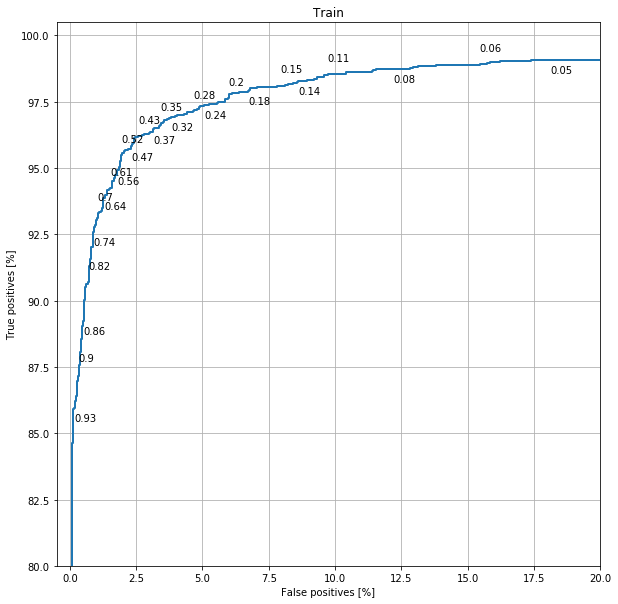

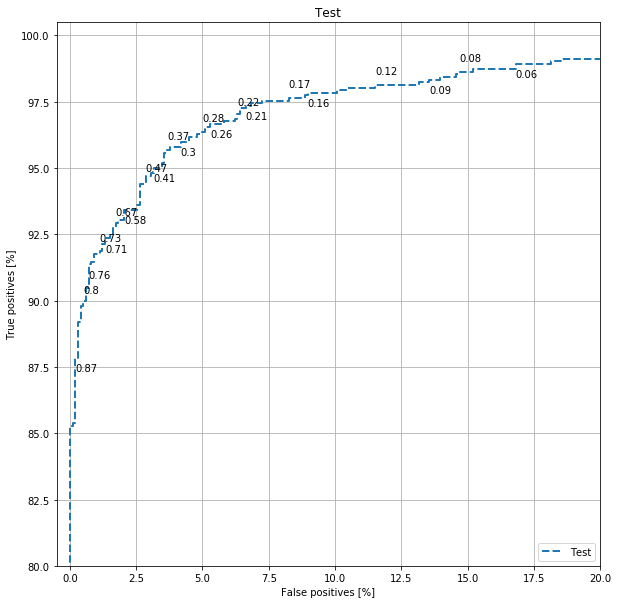

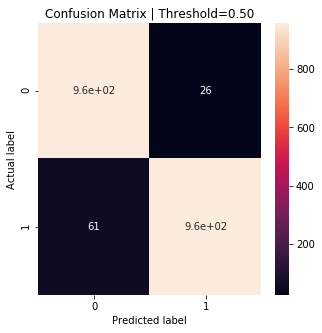

In [1074]:
threshold = .5
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7"
plot_roc_and_cm(model_path,threshold)

## Mobilenetv2 Trained On Cancer Threshold .1, Fine Tuned 

8/8 [==============================] - 55s 6s/step - loss: 0.0798 - tp: 599.8889 - fp: 12.7778 - tn: 602.1111 - fn: 26.1111 - accuracy: 0.9696 - precision: 0.9793 - recall: 0.9596 - auc: 0.9958 - prc: 0.9962
loss :  0.08668804913759232
tp :  976.0
fp :  22.0
tn :  959.0
fn :  43.0
accuracy :  0.9674999713897705
precision :  0.9779559373855591
recall :  0.9578017592430115
auc :  0.9951117038726807
prc :  0.9957692623138428


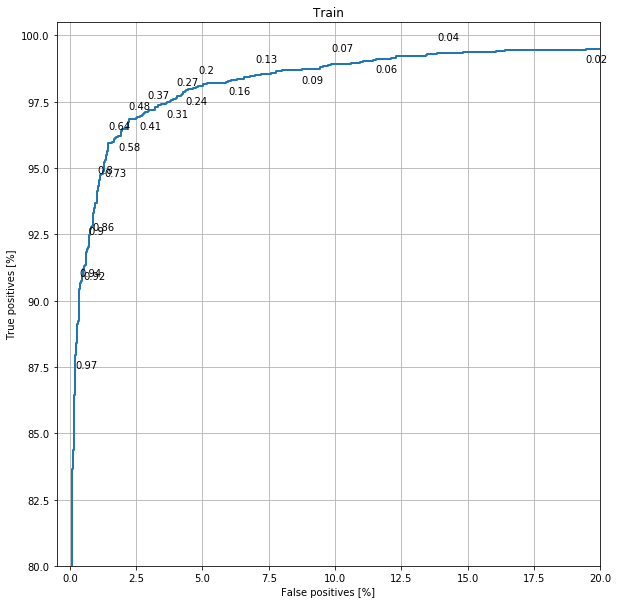

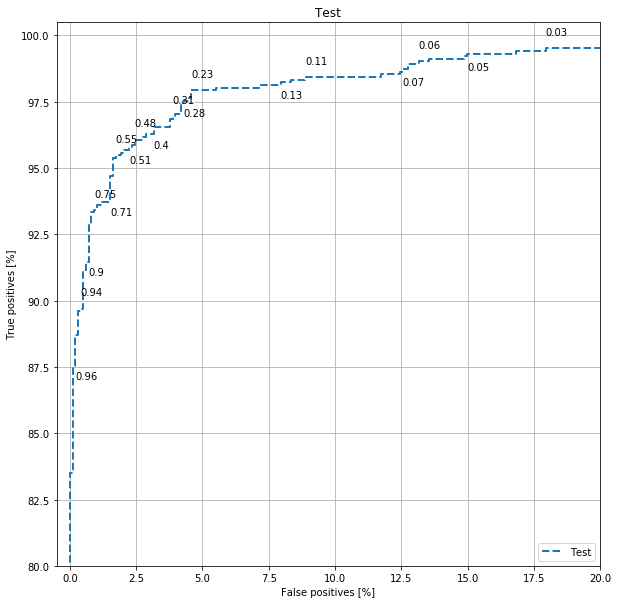

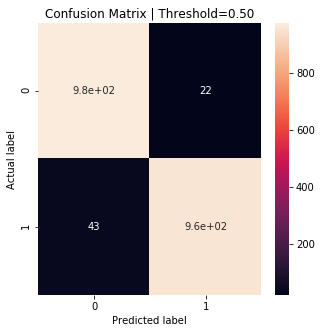

In [1075]:
threshold = .5
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 1/mobilnetv2_7_fine_tuned"
plot_roc_and_cm(model_path,threshold)

## Mobilenetv2 Trained On Cancer Threshold .3

8/8 [==============================] - 56s 6s/step - loss: 0.0653 - tp: 610.4444 - fp: 11.8889 - tn: 603.0000 - fn: 15.5556 - accuracy: 0.9781 - precision: 0.9814 - recall: 0.9748 - auc: 0.9971 - prc: 0.9974
loss :  0.0681333839893341
tp :  993.0
fp :  21.0
tn :  960.0
fn :  26.0
accuracy :  0.9764999747276306
precision :  0.9792899489402771
recall :  0.9744848012924194
auc :  0.9969499111175537
prc :  0.9973277449607849


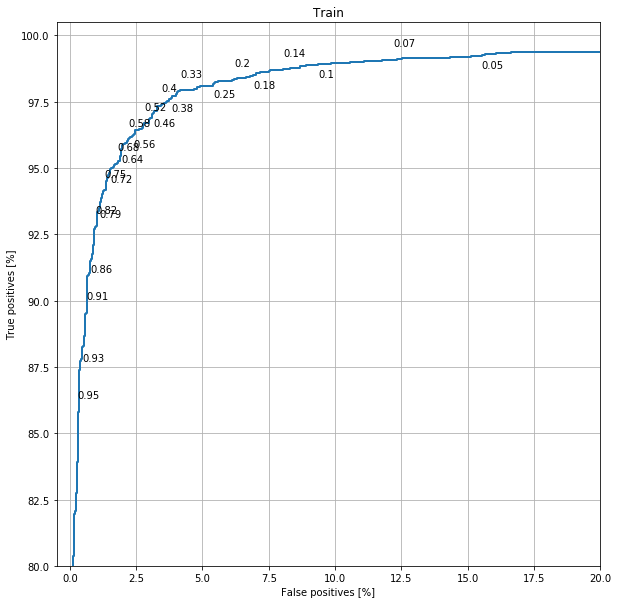

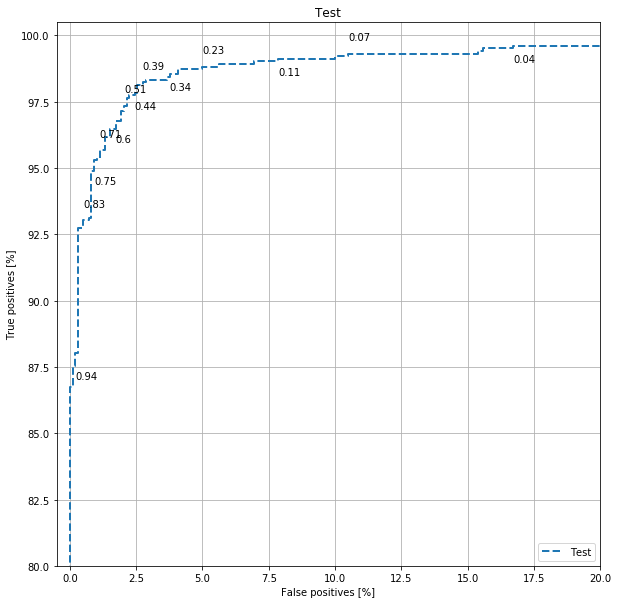

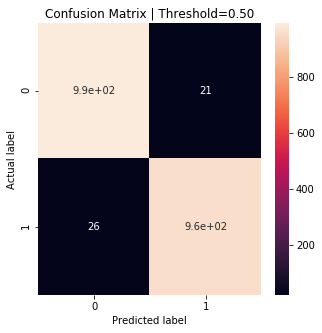

In [1081]:
threshold = .5
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 3/mobilnetv2_3"
plot_roc_and_cm(model_path,threshold)

## Mobilenetv2 Trained On Cancer Threshold .3, Fine Tuned

8/8 [==============================] - 59s 7s/step - loss: 0.0534 - tp: 613.8889 - fp: 9.8889 - tn: 605.0000 - fn: 12.1111 - accuracy: 0.9815 - precision: 0.9833 - recall: 0.9797 - auc: 0.9975 - prc: 0.9980
loss :  0.05470922961831093
tp :  1001.0
fp :  17.0
tn :  964.0
fn :  18.0
accuracy :  0.9825000166893005
precision :  0.9833005666732788
recall :  0.98233562707901
auc :  0.9976582527160645
prc :  0.998051643371582


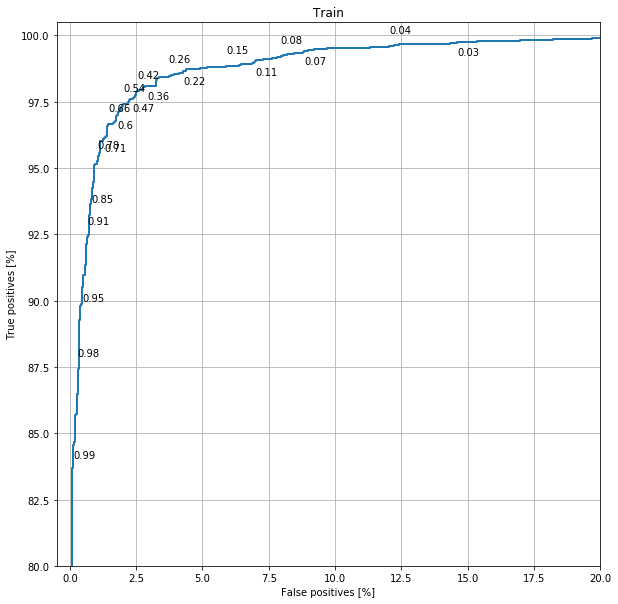

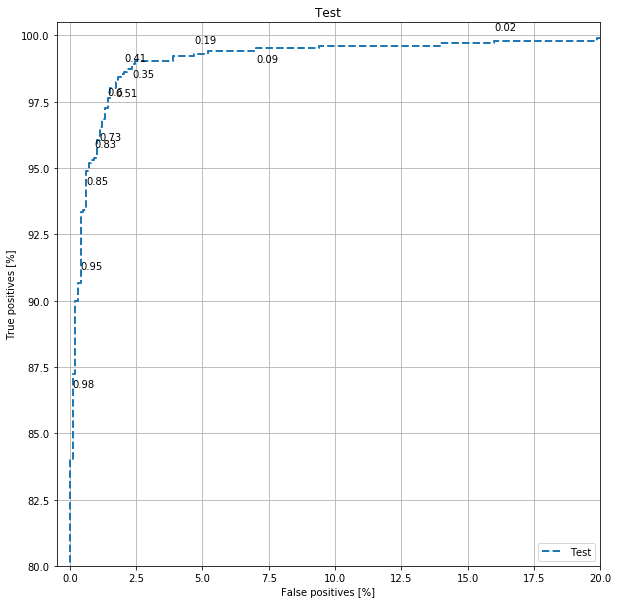

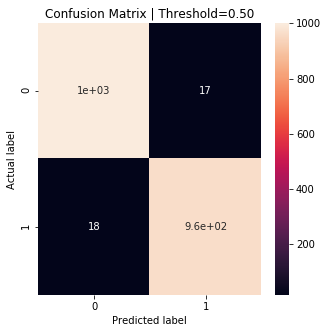

In [1082]:
threshold = .5
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 3/mobilnetv2_3_fine_tuned"
plot_roc_and_cm(model_path,threshold)

## Mobilenetv2 Trained On Cancer Threshold .3, Augmented Data

8/8 [==============================] - 66s 7s/step - loss: 0.0825 - tp: 617.4444 - fp: 32.1111 - tn: 582.7778 - fn: 8.5556 - accuracy: 0.9669 - precision: 0.9487 - recall: 0.9872 - auc: 0.9972 - prc: 0.9976
loss :  0.0865979790687561
tp :  1005.0
fp :  53.0
tn :  928.0
fn :  14.0
accuracy :  0.9664999842643738
precision :  0.9499054551124573
recall :  0.9862610697746277
auc :  0.9967477917671204
prc :  0.9971514344215393


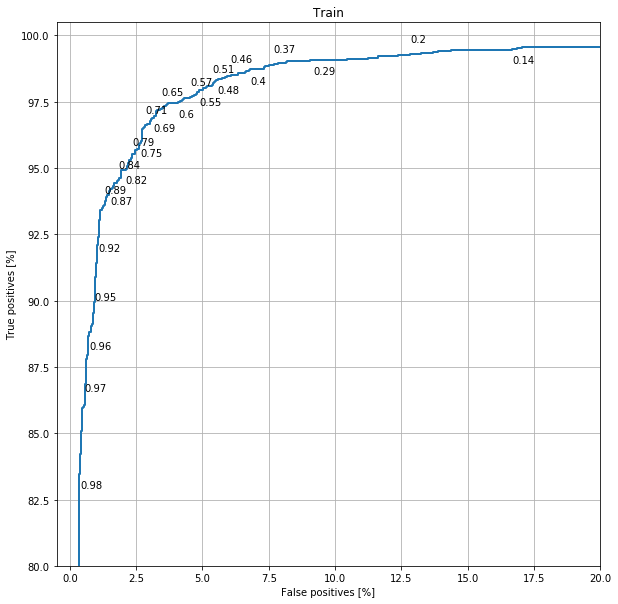

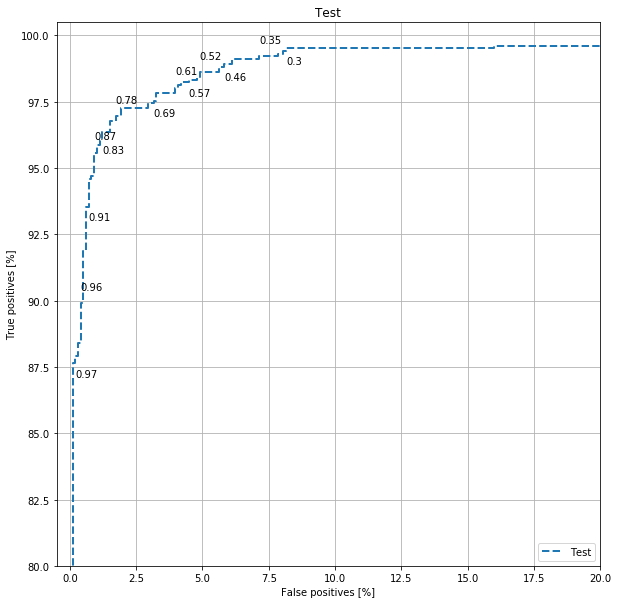

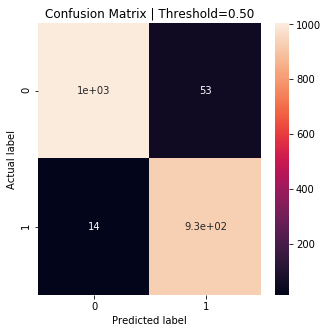

In [1083]:
threshold = .5
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 3/mobilnetv2_4_augmented"
plot_roc_and_cm(model_path,threshold)

## Mobilenetv2 Trained On Cancer Threshold .3, 2 Zooms 

8/8 [==============================] - 120s 14s/step - loss: 0.0562 - tp: 614.3333 - fp: 11.2222 - tn: 603.6667 - fn: 11.6667 - accuracy: 0.9814 - precision: 0.9815 - recall: 0.9813 - auc: 0.9977 - prc: 0.9972
loss :  0.05883841961622238
tp :  998.0
fp :  19.0
tn :  962.0
fn :  21.0
accuracy :  0.9800000190734863
precision :  0.9813175797462463
recall :  0.9793915748596191
auc :  0.9971104264259338
prc :  0.9959603548049927


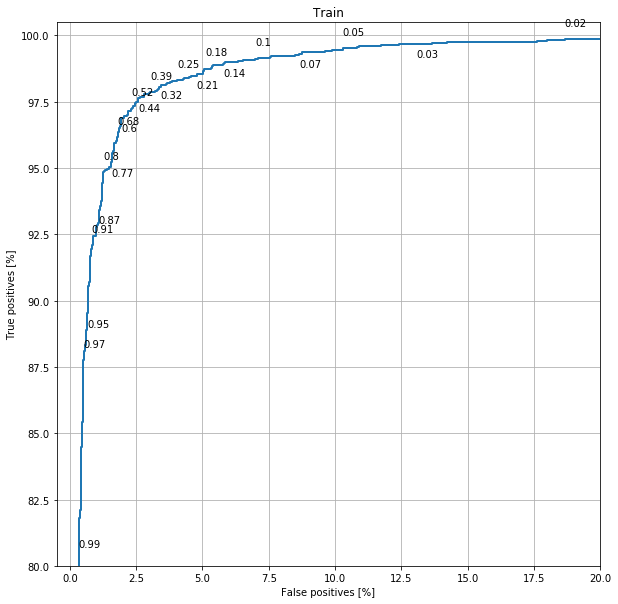

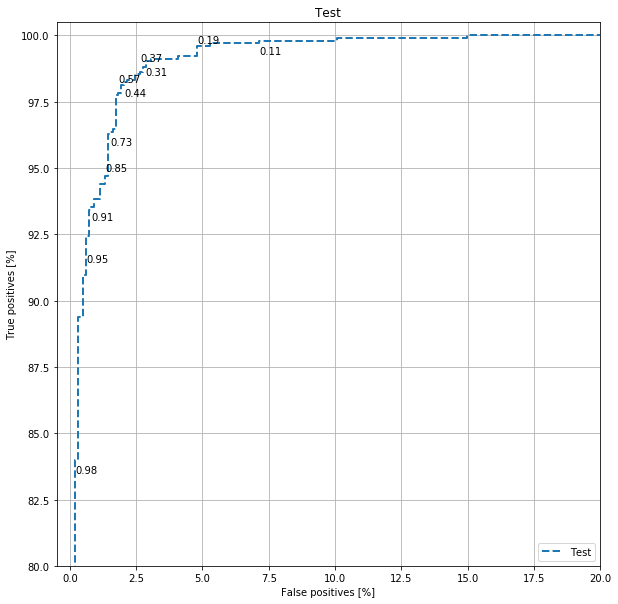

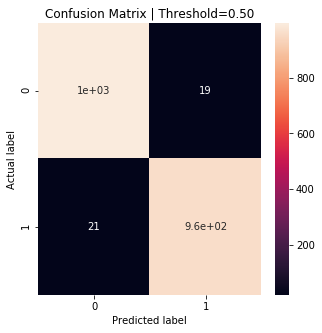

In [1105]:
threshold = .5
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/2_Zoom_Cancer_Value_3/mobilnetv2_6"
plot_roc_and_cm(model_path,threshold)

## Mobilenetv2 Trained On Cancer Threshold .5 

8/8 [==============================] - 62s 7s/step - loss: 0.0879 - tp: 608.5556 - fp: 26.7778 - tn: 588.1111 - fn: 17.4444 - accuracy: 0.9642 - precision: 0.9569 - recall: 0.9722 - auc: 0.9946 - prc: 0.9957
loss :  0.0990649089217186
tp :  990.0
fp :  44.0
tn :  937.0
fn :  29.0
accuracy :  0.9635000228881836
precision :  0.957446813583374
recall :  0.9715407490730286
auc :  0.9921822547912598
prc :  0.9942864179611206


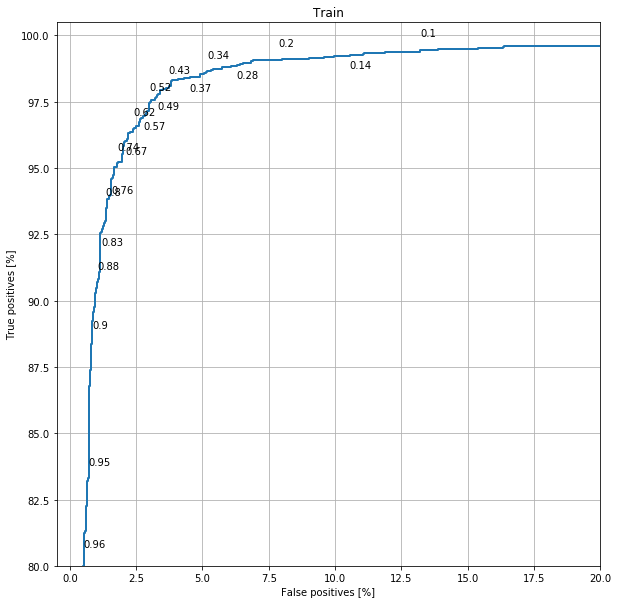

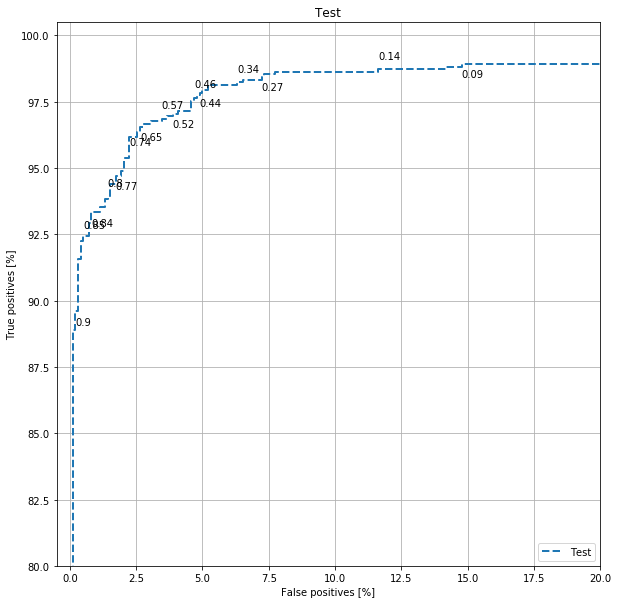

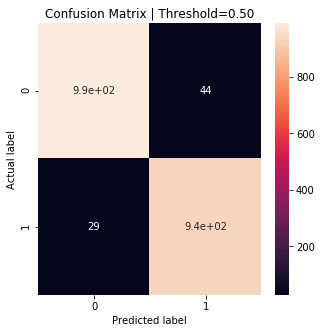

In [1111]:
threshold = .5
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 5/mobilnetv2_5"
plot_roc_and_cm(model_path,threshold)

# Slide Evaluation 

The following cells contain code for evaluating entire slides.

In [1129]:
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 3/mobilnetv2_3_fine_tuned"
result_root = "/Users/Daniel/Downloads/ADL Final Project Data/model results/"
model = tf.keras.models.load_model(model_path)
result_file_path = result_root + "_".join(model_path.split("/")[-2:]) + "_"
highest_zoom = 1
stride = 128
offset = 2
BATCH_SIZE = 512
slide_numbers = ["096","075","064","110","001"]
threshold = .6

In [1131]:
"""
Determines the number of cancerous regions in a slide and plots them along with the regions the model did not detect.

Parameters:
    mask_image [numpy.array([int])]: true value slide mask
    predicted_mask [numpy.array(int)]: predicted slide mask
    file_path [string]: file path to story saved masks
Returns:
    None
"""
def Compute_And_Plot_Custom_Metric(mask_image,predicted_mask,file_path):
    structure = np.ones((3,3))
    new_mask_image = binary_dilation(mask_image,structure)
    structure = np.ones((3,3))
    lw, num = measurements.label(new_mask_image,structure)

    area = measurements.sum(new_mask_image, lw, index=np.arange(lw.max() + 1))
    index_count = list(zip(area,range(len(area))))

    remove = []
    for i,j in index_count:
        if i < 2:
            remove.append(j)
    reduced_array = np.where(np.isin(lw,np.array(remove)), 0.0, lw)
    categories = np.unique(reduced_array)

    undetected_cat = []
    overlap = 0
    for cat in categories:
        cnt = np.sum((np.where(predicted_mask==0,-1,predicted_mask)*cat)==reduced_array)
        if cnt > 0:
            overlap += 1
        else:
            undetected_cat.append(cat)

    metric = (overlap-1)/(categories.shape[0]-1)
    print("Percentage of Cancerous Regions Identified:",metric*100,"%")

    fig, ax = plt.subplots(1,2,figsize=(20,20))

    _=ax[0].imshow(slide_image)
    _=ax[0].imshow(lw,alpha=.8)
    _=ax[0].set_title(str(categories.shape[0]-1) +" Cancerous Regions")
     
    non_detected_cancerous_array = np.where(np.isin(reduced_array,undetected_cat),categories.shape[0]**2,0)

    _=ax[1].imshow(slide_image)
    _=ax[1].imshow(non_detected_cancerous_array,alpha=.8)
    _=ax[1].set_title(str(categories.shape[0]-overlap) +" Non-Detected Cancerous Region(s)")
    
    fig.savefig(file_path+"_regions.png")

'\nDetermines the number of cancerous regions in a slide and plots them along with the regions the model did not detect.\n\nParameters:\n    mask_image [numpy.array([int])]: true value slide mask\n    predicted_mask [numpy.array(int)]: predicted slide mask\n    file_path [string]: file path to story saved masks\nReturns:\n    None\n'

100% (280 of 280) |######################| Elapsed Time: 0:33:46 Time:  0:33:46


Slide Number: 096 AUC_ROC: 0.6774131161104121 TP: 127 FP: 131 TN: 142872 FN: 230
Percentage of Cancerous Regions Identified: 55.55555555555556 %


100% (308 of 308) |######################| Elapsed Time: 0:20:44 Time:  0:20:44


Slide Number: 075 AUC_ROC: 0.6639660555500361 TP: 247 FP: 341 TN: 107329 FN: 499
Percentage of Cancerous Regions Identified: 75.0 %


100% (862 of 862) |######################| Elapsed Time: 0:26:16 Time:  0:26:16


Slide Number: 064 AUC_ROC: 0.7531343968818626 TP: 1032 FP: 36 TN: 327210 FN: 1006
Percentage of Cancerous Regions Identified: 83.33333333333334 %


100% (280 of 280) |######################| Elapsed Time: 0:25:38 Time:  0:25:38


Slide Number: 110 AUC_ROC: 0.9741138948093055 TP: 15415 FP: 937 TN: 86029 FN: 659
Percentage of Cancerous Regions Identified: 100.0 %


100% (864 of 864) |######################| Elapsed Time: 0:35:08 Time:  0:35:08


Slide Number: 001 AUC_ROC: 0.7190207889182084 TP: 78 FP: 53 TN: 329817 FN: 100
Percentage of Cancerous Regions Identified: 100.0 %


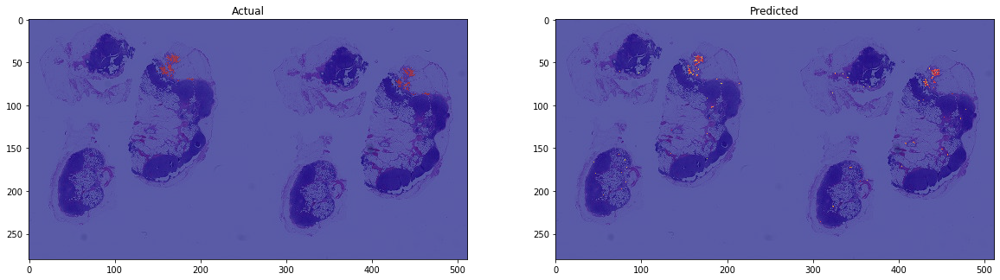

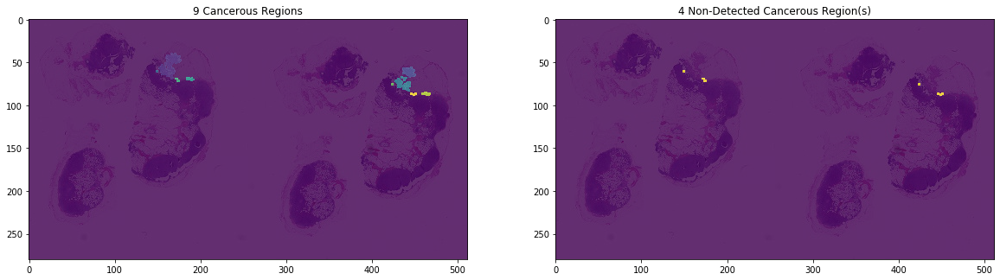

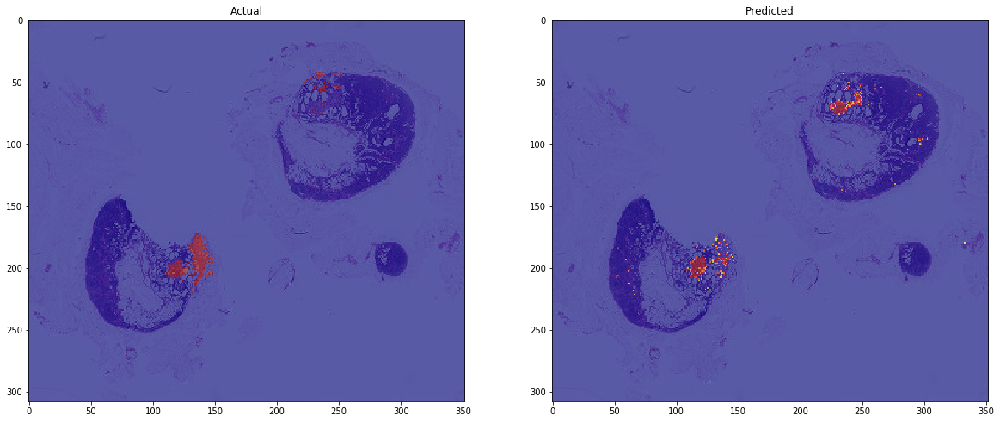

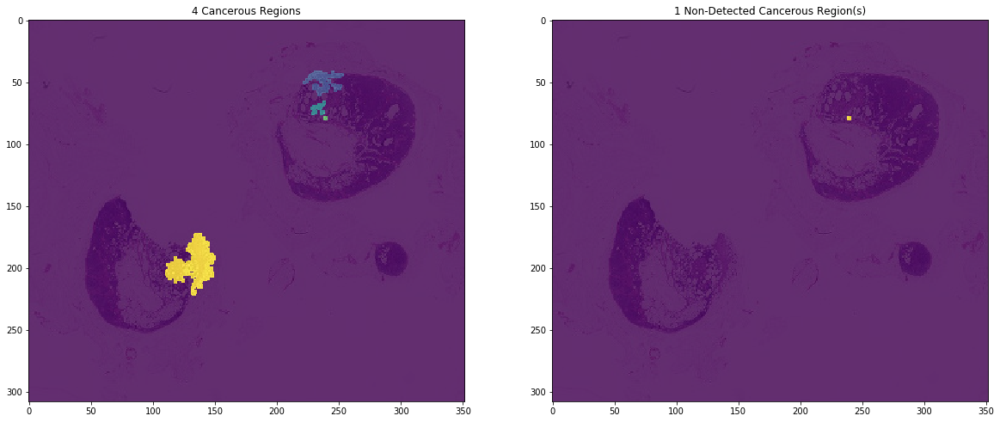

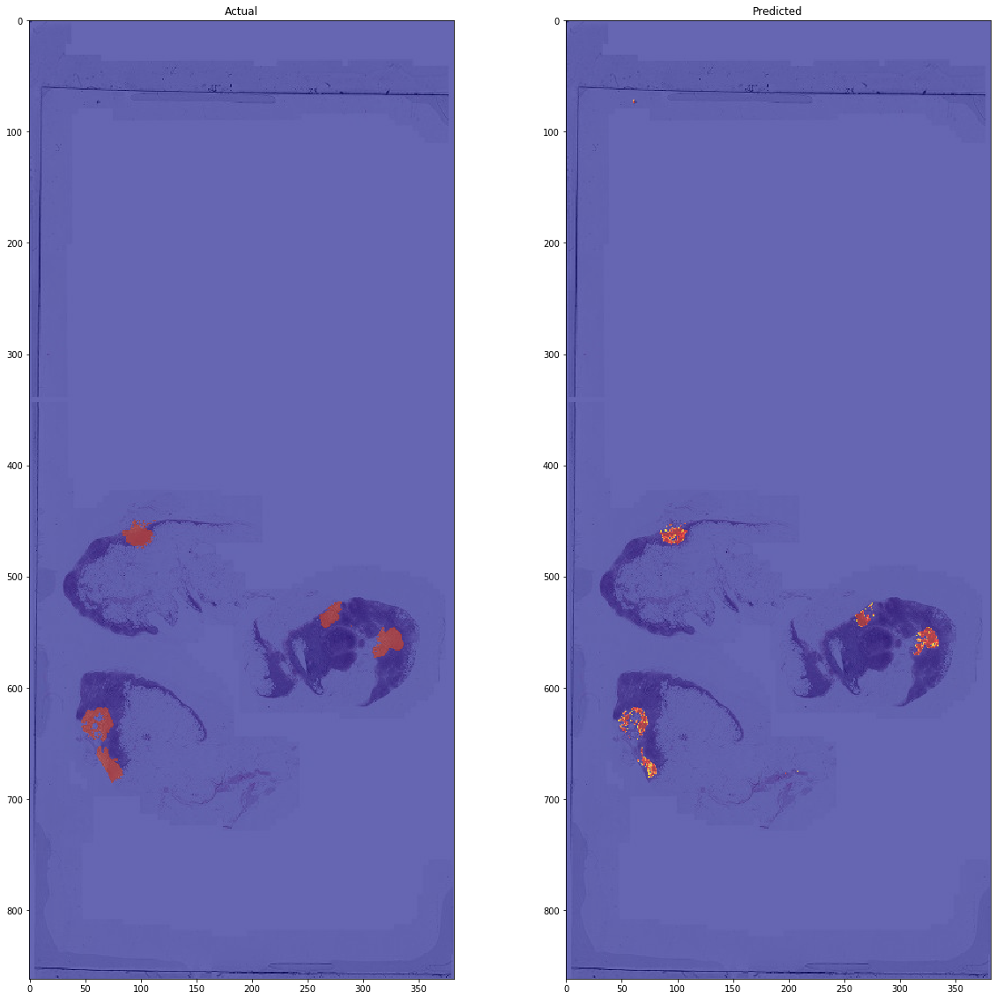

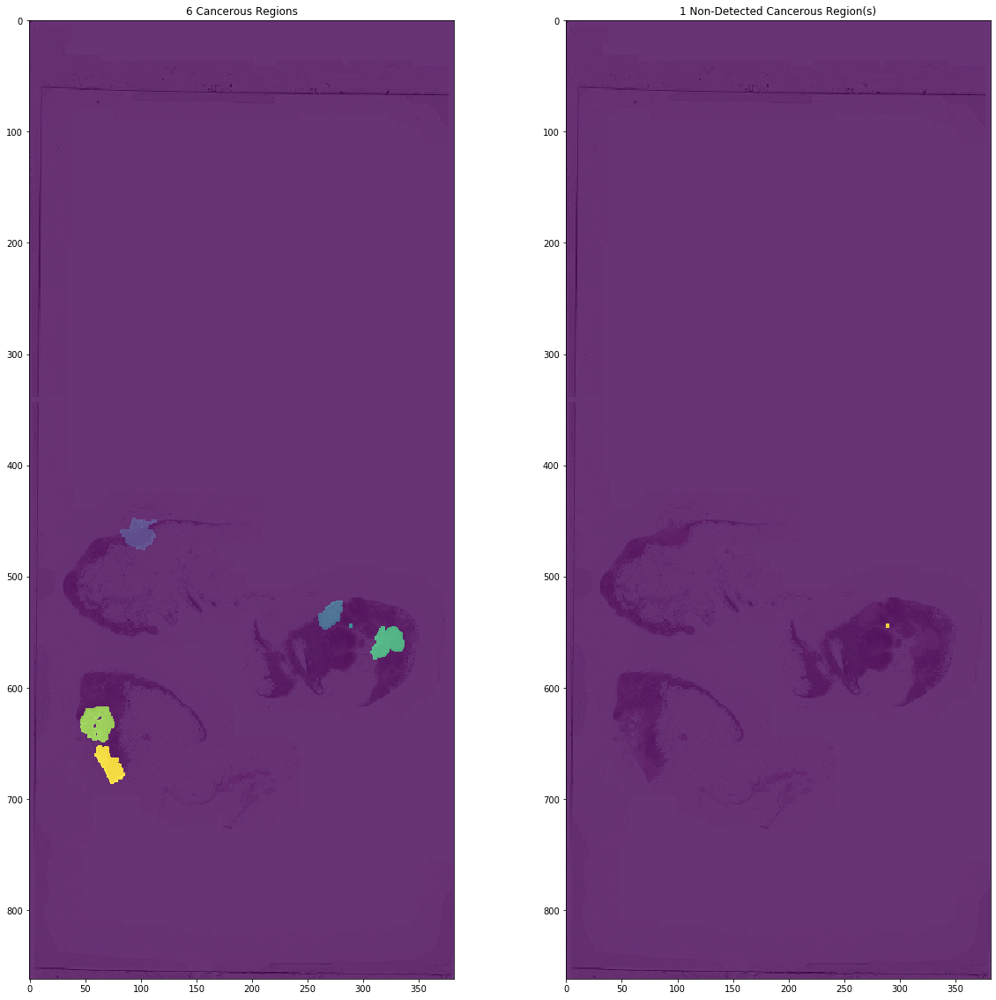

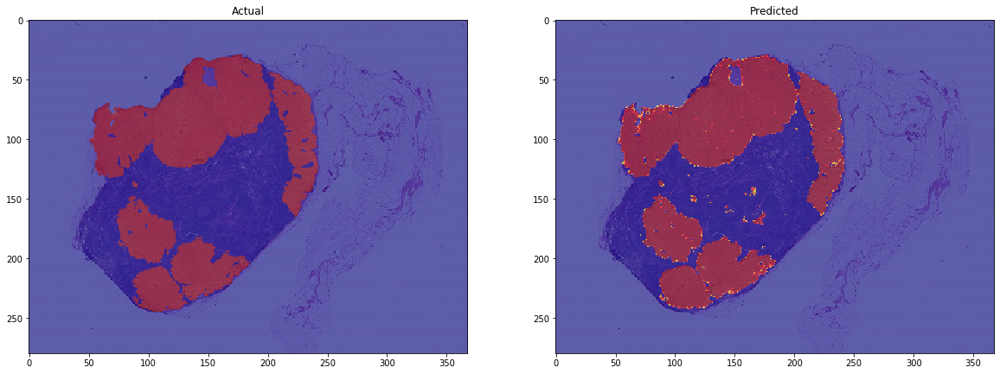

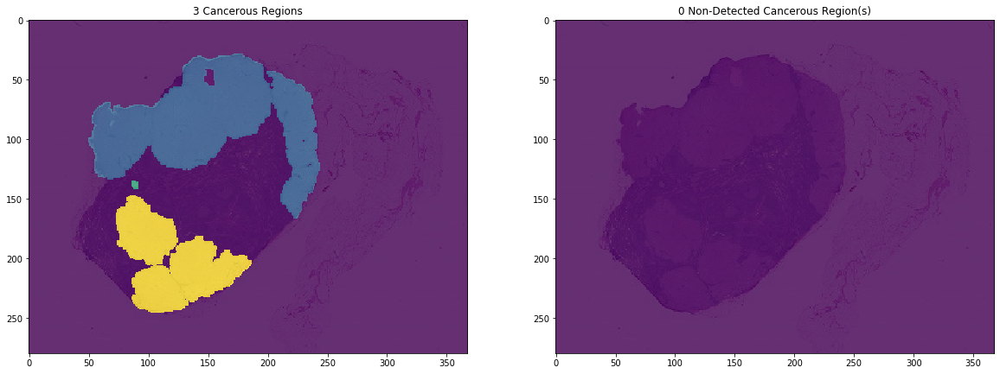

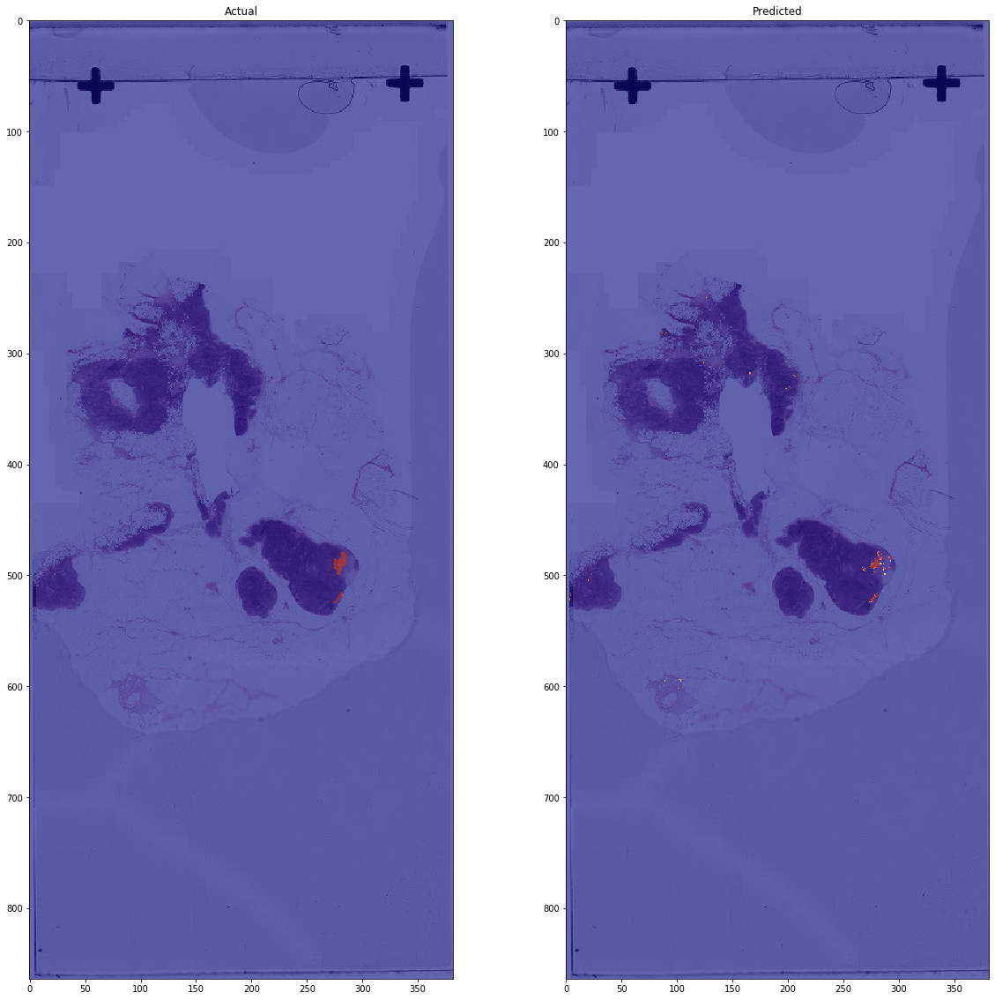

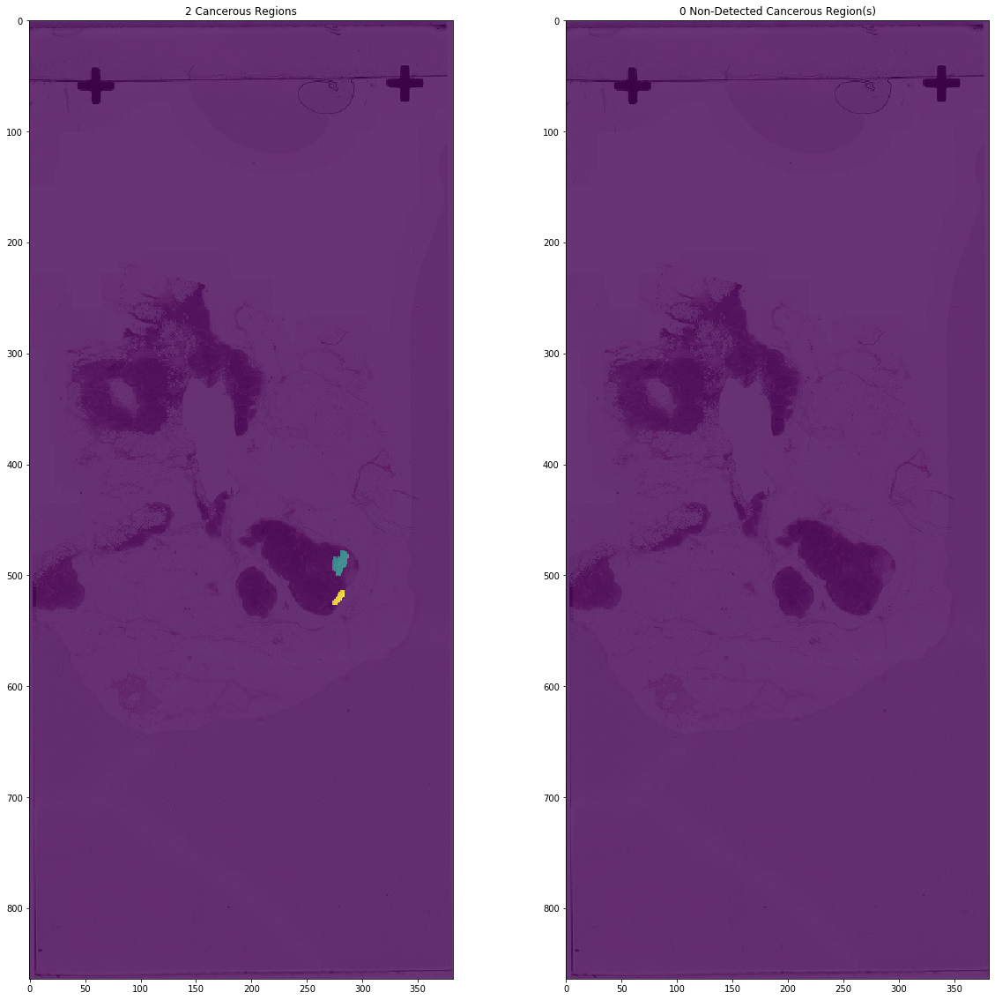

In [1132]:
# script for evaluating an array of slides
# iterates through all the 299X299 patches of a slide and stores the prediction in an array which becomes the heatmap
for slide_number in slide_numbers:
    root_data_path = "/Users/Daniel/Downloads/ADL Final Project Data/slides/"
    slide_path = root_data_path + "tumor_" + slide_number + ".tif"
    mask_path = root_data_path + "tumor_" + slide_number + "_mask.tif"
    slide_selection = "tumor_" + slide_number
    slide_number = slide_selection.split("_")[1]
    slide = open_slide(slide_path)

    dimensions = slide.level_dimensions
    downsamples = slide.level_downsamples
    highest_dimensions = dimensions[highest_zoom]
    highest_downsample = int(downsamples[highest_zoom])

    x,y = highest_dimensions
    x_range = int(x/128)
    y_range = int(y/128)

    def Get_Test_Data(coordinates):
        images_batch = tf.TensorArray(tf.float32, size=0, dynamic_size=True)
        coordinates_batch = tf.TensorArray(tf.int32, size=0, dynamic_size=True) 
        for coordinate in coordinates:
            img = read_slide(slide, 
                    x=int(128*coordinate[0]*highest_downsample)-85,
                    y=int(128*coordinate[1]*highest_downsample)-85,
                    level=highest_zoom, width=299, height=299)
            if Is_Grey(img):
                continue
            standard_img = img/255.0
            images_batch = images_batch.write(images_batch.size(),standard_img)
            coordinates_batch = coordinates_batch.write(coordinates_batch.size(),coordinate)
        return images_batch.stack(), coordinates_batch.stack()

    indexes = []
    y=-stride+(offset)*stride
    for j in range(offset,y_range-offset):
        y += stride 
        x = -stride+(offset)*stride
        for i in range(offset,x_range-offset):
            indexes.append([i,j]) # x,y

    dataset = tf.data.Dataset.from_tensor_slices(indexes).batch(BATCH_SIZE).map(lambda x: tf.py_function(func=Get_Test_Data,inp=[x],Tout=[tf.float32,tf.int32]),num_parallel_calls=tf.data.experimental.AUTOTUNE).filter(lambda a,b: tf.not_equal(tf.size(b), 0)).prefetch(tf.data.experimental.AUTOTUNE)

    predicted_mask = np.zeros((y_range,x_range))
    heatmap_mask = np.zeros((y_range,x_range))
    with progressbar.ProgressBar(max_value=y_range) as bar:  
        for i,j in dataset:
            predictions = model.predict(i)
            for count, prediction in enumerate(predictions):
                if prediction[0] >= threshold:
                    predicted_mask[j[count][1],j[count][0]] = 1 # y,x
                    heatmap_mask[j[count][1],j[count][0]] = prediction[0] # heatmap
                bar.update(j[count][1].numpy())

    slide = open_slide(slide_path)
    slide_image = read_slide(slide,x=0,y=0,level=8, 
                             width=slide.level_dimensions[8][0], 
                             height=slide.level_dimensions[8][1])

    mask = open_slide(mask_path)
    mask_image = read_slide(mask,x=0,y=0,level=8, 
                            width=mask.level_dimensions[8][0], 
                            height=mask.level_dimensions[8][1])[:,:,0]
    
    tn, fp, fn, tp = confusion_matrix(mask_image.reshape(1,-1)[0], (predicted_mask).reshape(1,-1)[0]).ravel()
    auc_roc = roc_auc_score(mask_image.reshape(1,-1)[0], (predicted_mask).reshape(1,-1)[0])
    print("Slide Number:",slide_number, "AUC_ROC:",auc_roc,"TP:",tp,"FP:",fp,"TN:",tn,"FN:",fn)

    fig, ax = plt.subplots(1,2,figsize=(20,20))
    _=ax[0].set_title("Actual")
    _=ax[0].imshow(slide_image)
    _=ax[0].imshow(mask_image, cmap='jet', alpha=.6)
    _=ax[1].set_title("Predicted")
    _=ax[1].imshow(slide_image)
    _=ax[1].imshow(heatmap_mask, cmap='jet', alpha=.6)
    
    fig.savefig(result_file_path+slide_number+"_predicted.png")
    
    Compute_And_Plot_Custom_Metric(mask_image,predicted_mask,(result_file_path+slide_number))

# Model Interpertation 

Adapted from https://www.tensorflow.org/tutorials/interpretability/integrated_gradients

In [459]:
def read_image(file_name):
  image = tf.io.read_file(file_name)
  image = tf.image.decode_jpeg(image, channels=3)
  image = tf.cast(image, tf.float32)
  image /= 255
  return image

def interpolate_images(baseline,image,alphas):
  alphas_x = alphas[:, tf.newaxis, tf.newaxis, tf.newaxis]
  baseline_x = tf.expand_dims(baseline, axis=0)
  input_x = tf.expand_dims(image, axis=0)
  delta = input_x - baseline_x
  images = baseline_x +  alphas_x * delta
  return images

def compute_gradients(images,model):
  with tf.GradientTape() as tape:
    tape.watch(images)
    logits = model(images)
  return tape.gradient(logits, images)

def integral_approximation(gradients):
  grads = (gradients[:-1] + gradients[1:]) / tf.constant(2.0)
  integrated_gradients = tf.math.reduce_mean(grads, axis=0)
  return integrated_gradients

@tf.function
def integrated_gradients(baseline,image,model, m_steps=50,batch_size=32):
  alphas = tf.linspace(start=0.0, stop=1.0, num=m_steps+1)  
  gradient_batches = tf.TensorArray(tf.float32, size=m_steps+1)
    
  for alpha in tf.range(0, len(alphas), batch_size):
    from_ = alpha
    to = tf.minimum(from_ + batch_size, len(alphas))
    alpha_batch = alphas[from_:to]
    interpolated_path_input_batch = interpolate_images(baseline=baseline,image=image,alphas=alpha_batch)
    gradient_batch = compute_gradients(images=interpolated_path_input_batch,model=model)
    gradient_batches = gradient_batches.scatter(tf.range(from_, to), gradient_batch)    
  total_gradients = gradient_batches.stack()
  avg_gradients = integral_approximation(gradients=total_gradients)
  integrated_gradients = (image - baseline) * avg_gradients
  return integrated_gradients

def plot_img_attributions(baseline,model,image,m_steps=50,cmap=None,overlay_alpha=0.4):
  attributions = integrated_gradients(baseline=baseline,image=image,model=model,m_steps=m_steps)
  attribution_mask = tf.reduce_sum(tf.math.abs(attributions), axis=-1)
  fig, axs = plt.subplots(nrows=2, ncols=2, squeeze=False, figsize=(8, 8))
  axs[0, 0].set_title('Baseline image')
  axs[0, 0].imshow(baseline)
  axs[0, 0].axis('off')
  axs[0, 1].set_title('Original image')
  axs[0, 1].imshow(image)
  axs[0, 1].axis('off')
  axs[1, 0].set_title('Attribution mask')
  axs[1, 0].imshow(attribution_mask, cmap=cmap)
  axs[1, 0].axis('off')
  axs[1, 1].set_title('Overlay')
  axs[1, 1].imshow(attribution_mask, cmap=cmap)
  axs[1, 1].imshow(image, alpha=overlay_alpha)
  axs[1, 1].axis('off')
  plt.tight_layout()
  return fig

In [460]:
model_path = "/Users/Daniel/Downloads/ADL Final Project Data/models/Cancer Value 3/mobilnetv2_3"
base_path ="/Users/Daniel/Downloads/ADL Final Project Data/data_cancer_value_3/level_1/cancer/"
img_files = ["016_10272.jpeg","016_11297.jpeg","016_12529.jpeg","031_3915.jpeg","078_3246.jpeg","094_4542.jpeg"]

In [461]:
model = tf.keras.models.load_model(model_path)
read_images = []
for img_name in img_files:
    img = read_image(base_path+img_name)
    read_images.append(img)
    img = tf.expand_dims(img,axis=0)
    model.predict(img)

array([[0.99916214]], dtype=float32)

array([[0.99889755]], dtype=float32)

array([[0.98033625]], dtype=float32)

array([[0.9998107]], dtype=float32)

array([[0.9999182]], dtype=float32)

array([[0.81598115]], dtype=float32)

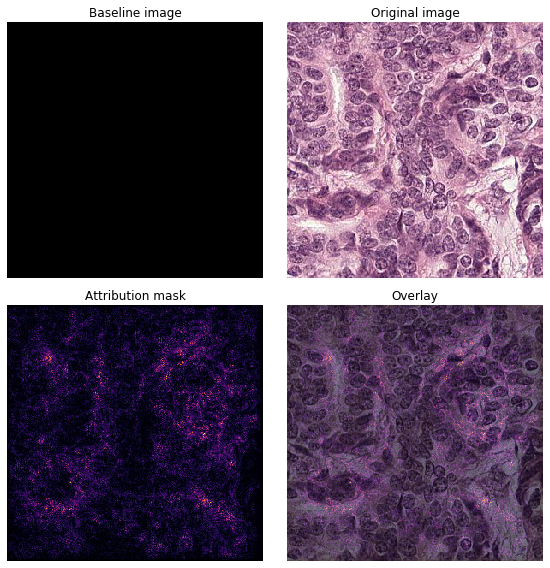

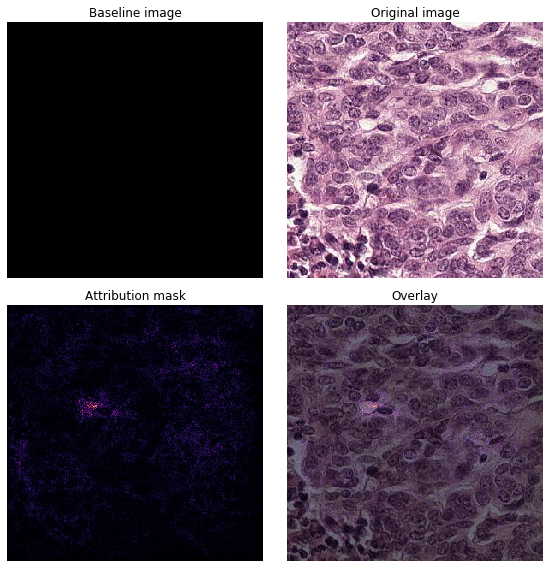

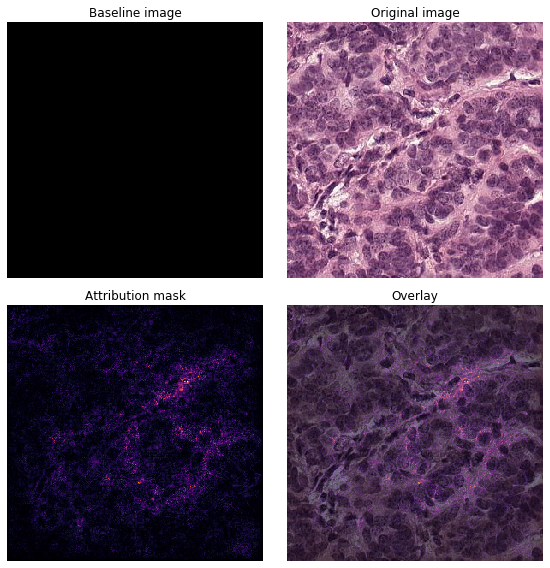

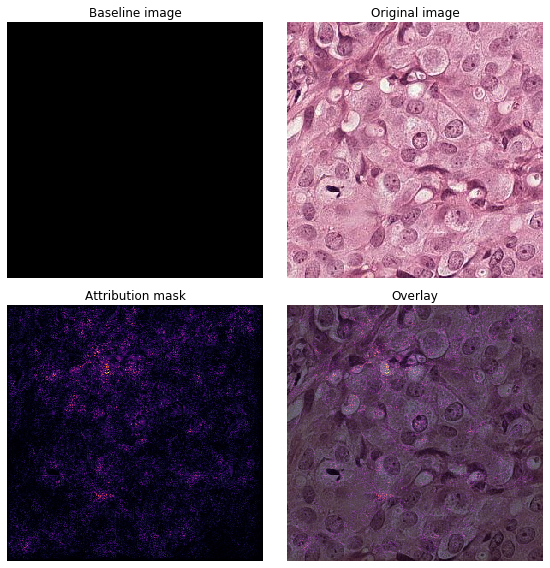

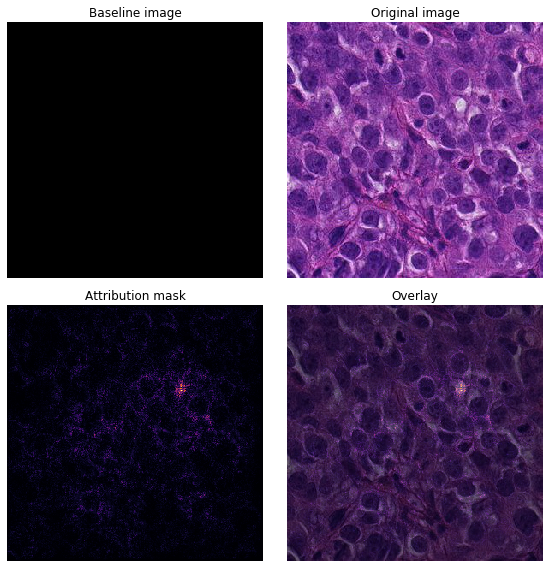

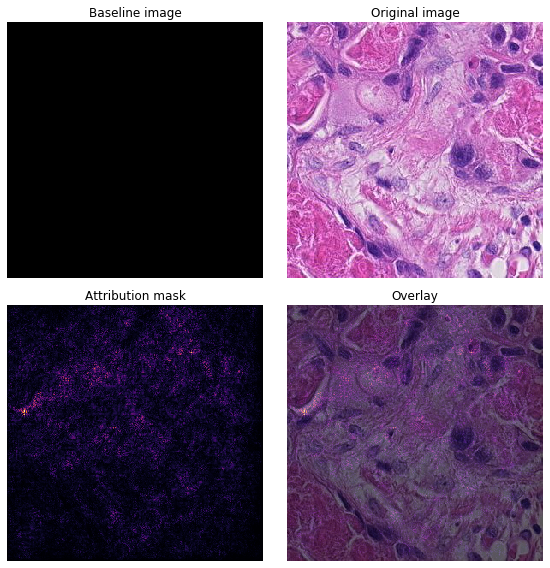

In [462]:
baseline = tf.zeros(shape=(299,299,3))
for img in read_images:
    _ = plot_img_attributions(image=img,baseline=baseline,model=model,m_steps=240,cmap=plt.cm.inferno,overlay_alpha=0.4)    